# **HOUSE PRICE PREDICTION**

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor


from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [4]:
file_path2 = '/content/drive/My Drive/cleaned_data_v2.csv'

In [5]:
df= pd.read_csv(file_path2)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 20 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   price                        21613 non-null  float64
 1   bedrooms                     21613 non-null  int64  
 2   bathrooms                    21613 non-null  float64
 3   sqft_lot                     21613 non-null  int64  
 4   floors                       21613 non-null  float64
 5   waterfront                   21613 non-null  int64  
 6   view                         21613 non-null  int64  
 7   condition                    21613 non-null  int64  
 8   yr_built                     21613 non-null  int64  
 9   yr_renovated                 21613 non-null  int64  
 10  zipcode                      21613 non-null  int64  
 11  lat                          21613 non-null  float64
 12  long                         21613 non-null  float64
 13  nearest_station_

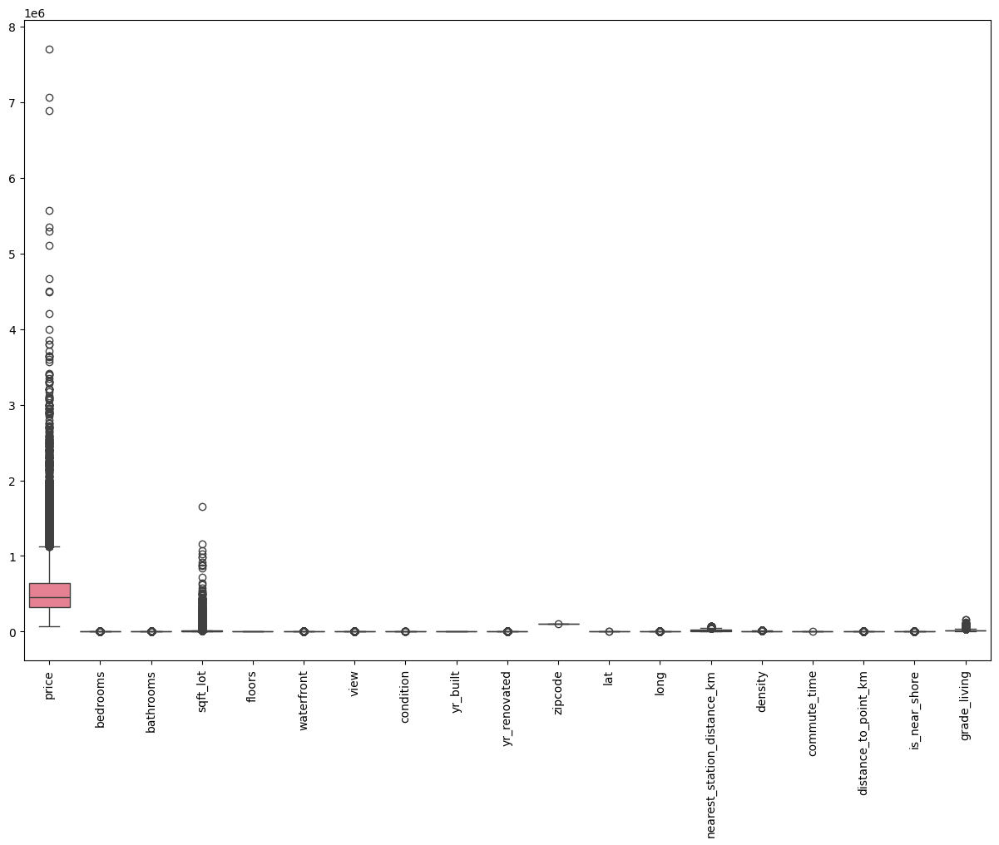

(array([    1,     5,     5, ..., 21590, 21600, 21603]), array([ 9,  2, 17, ..., 17, 17, 16]))


In [ ]:
# Boxplot ile aykırı değerlerin görselleştirilmesi
plt.figure(figsize=(15, 10))
sns.boxplot(data=df)
plt.xticks(rotation=90)
plt.show()

# Z-score yöntemi ile aykırı değerlerin tespiti
from scipy import stats
import numpy as np

z_scores = np.abs(stats.zscore(df.select_dtypes(include=[np.number])))
print(np.where(z_scores > 3))  # Z-score > 3 olan aykırı değerlerin indeksleri


In [ ]:
threshold = 3
data_cleaned = df[(z_scores < threshold).all(axis=1)]


In [ ]:
from sklearn.preprocessing import StandardScaler

# İlgili özellikleri seçme
features = ['price', 'bedrooms', 'bathrooms', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition',
            'yr_built', 'yr_renovated', 'lat', 'long', 'nearest_station_distance_km', 'density',
            'commute_time', 'distance_to_point_km', 'is_near_shore', 'grade_living']

# Özellikleri çıkartma
data_features = data_cleaned[features]

# Özellikleri standartlaştırma
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data_features)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

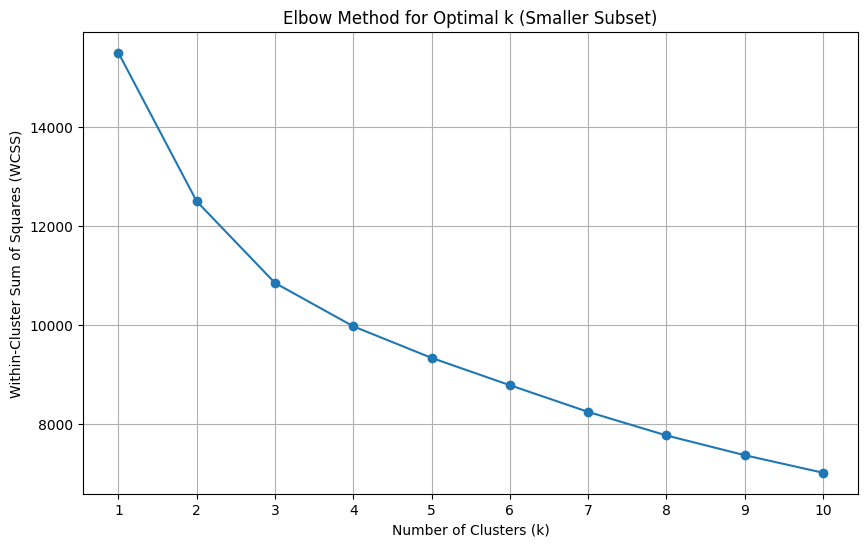

In [ ]:
from sklearn.cluster import KMeans

# Küçük bir alt küme kullanarak WCSS hesaplama
data_subset_small = data_features_scaled[:1000]
wcss_subset_small = []
k_values = range(1, 11)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_subset_small)
    wcss_subset_small.append(kmeans.inertia_)

# Elbow Yöntemini görselleştirme
plt.figure(figsize=(10, 6))
plt.plot(k_values, wcss_subset_small, marker='o', linestyle='-')
plt.title('Elbow Method for Optimal k (Smaller Subset)')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.xticks(k_values)
plt.grid(True)
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-3cee158ab537>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cleaned['Cluster'] = clusters


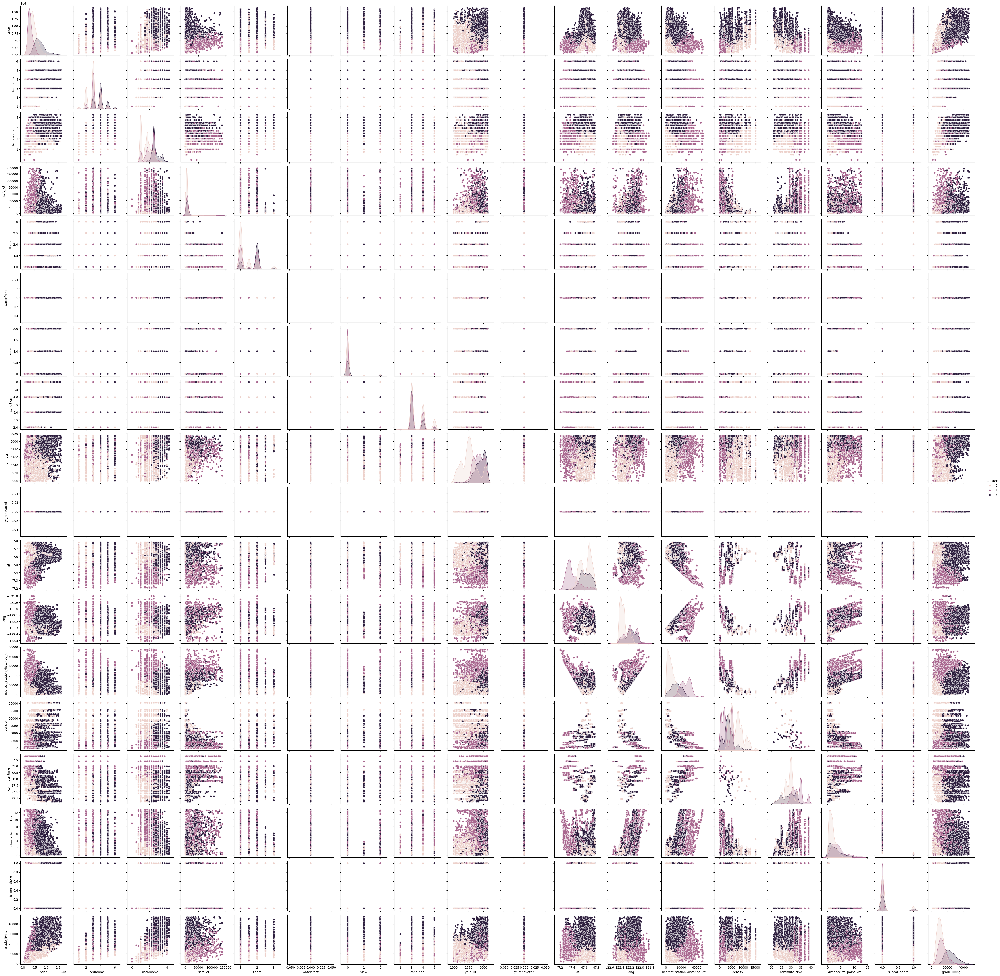

In [ ]:
# Optimal k değerini belirledikten sonra tüm veri kümesinde K-means uygulama
optimal_k = 3  # Örneğin, Elbow yönteminden 3 olduğunu varsayalım
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
clusters = kmeans.fit_predict(data_features_scaled)

# Sonuçları orijinal veri kümesine ekleme
data_cleaned['Cluster'] = clusters

# Küme dağılımını görselleştirme
sns.pairplot(data_cleaned, hue='Cluster', vars=features)
plt.show()


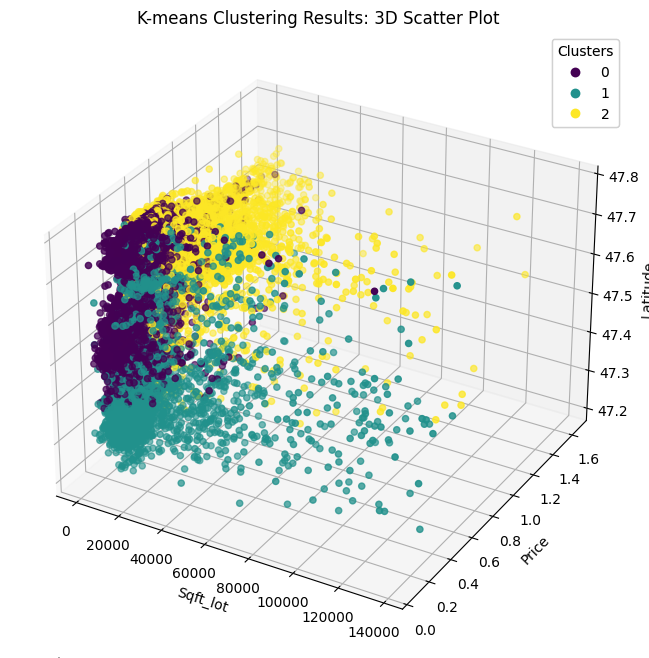

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# 3D Scatter plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Veriyi görselleştirme
scatter = ax.scatter(data_cleaned['sqft_lot'], data_cleaned['price'], data_cleaned['lat'], c=data_cleaned['Cluster'], cmap='viridis')

# Eksen etiketleri
ax.set_xlabel('Sqft_lot')
ax.set_ylabel('Price')
ax.set_zlabel('Latitude')
plt.title('K-means Clustering Results: 3D Scatter Plot')

# Renkli küme göstergesi ekleme
legend = ax.legend(*scatter.legend_elements(), title='Clusters')
ax.add_artist(legend)

plt.show()


**Standardize the Data**

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler

# Select relevant features
features = ['price', 'bedrooms', 'bathrooms', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition',
            'yr_built', 'yr_renovated', 'lat', 'long', 'nearest_station_distance_km', 'density',
            'commute_time', 'distance_to_point_km', 'is_near_shore', 'grade_living']

data_features = df[features]

# Standardize the features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data_features)


**Perform K-means Clustering**

In [ ]:
from sklearn.cluster import KMeans

# Perform K-means clustering with k=3
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_scaled)
df['Cluster'] = clusters


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


**Silhouette Analysis**

In [ ]:
from sklearn.metrics import silhouette_score

# Compute the silhouette score
silhouette_avg = silhouette_score(data_features_scaled, clusters)
print(f'Silhouette Score: {silhouette_avg}')


Silhouette Score: 0.18282497349453516


**Cluster Profiling**

In [ ]:
# Profile each cluster by examining the average values of features
cluster_profile = df.groupby('Cluster')[features].mean()
print(cluster_profile)


                price  bedrooms  bathrooms      sqft_lot    floors  \
Cluster                                                              
0        1.127809e+06  4.085724   3.015027  16028.746585  1.811817   
1        4.271202e+05  3.456079   2.247391  24629.094759  1.581655   
2        4.644620e+05  3.103131   1.757661   7333.306617  1.336350   

         waterfront      view  condition     yr_built  yr_renovated  \
Cluster                                                               
0          0.055328  1.186134   3.397199  1976.991462    238.180328   
1          0.000000  0.073283   3.301747  1986.954865     36.799685   
2          0.000096  0.094513   3.497845  1956.738581     78.855789   

               lat        long  nearest_station_distance_km      density  \
Cluster                                                                    
0        47.611171 -122.239763                  9403.945988  5862.603142   
1        47.465024 -122.106159                 26063.798509  2267

**Visualize the Cluster Centroids**

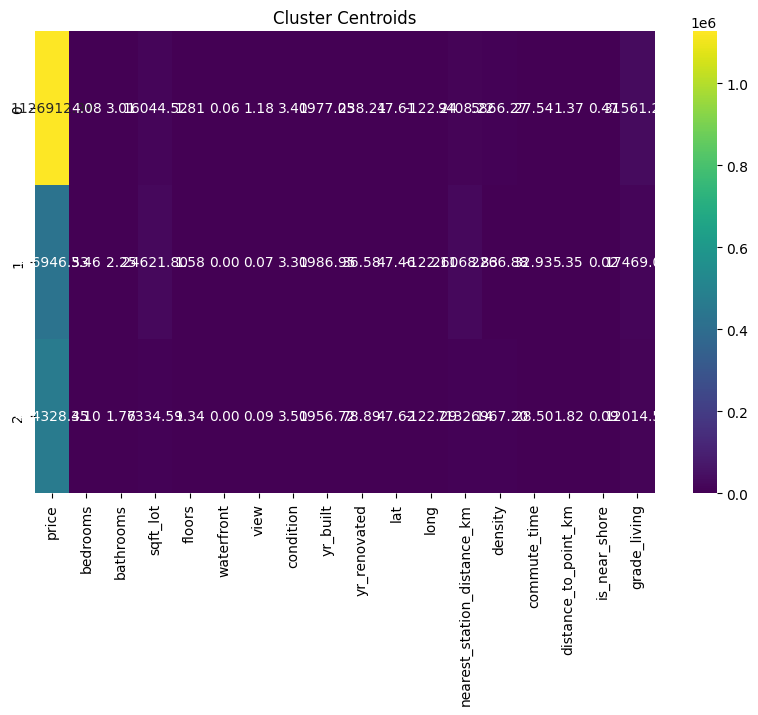

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting the centroids
centroids = kmeans.cluster_centers_
centroids_df = pd.DataFrame(scaler.inverse_transform(centroids), columns=features)

# Visualize the centroids
plt.figure(figsize=(10, 6))
sns.heatmap(centroids_df, annot=True, cmap='viridis', fmt='.2f')
plt.title('Cluster Centroids')
plt.show()


**Pairplot Visualization**

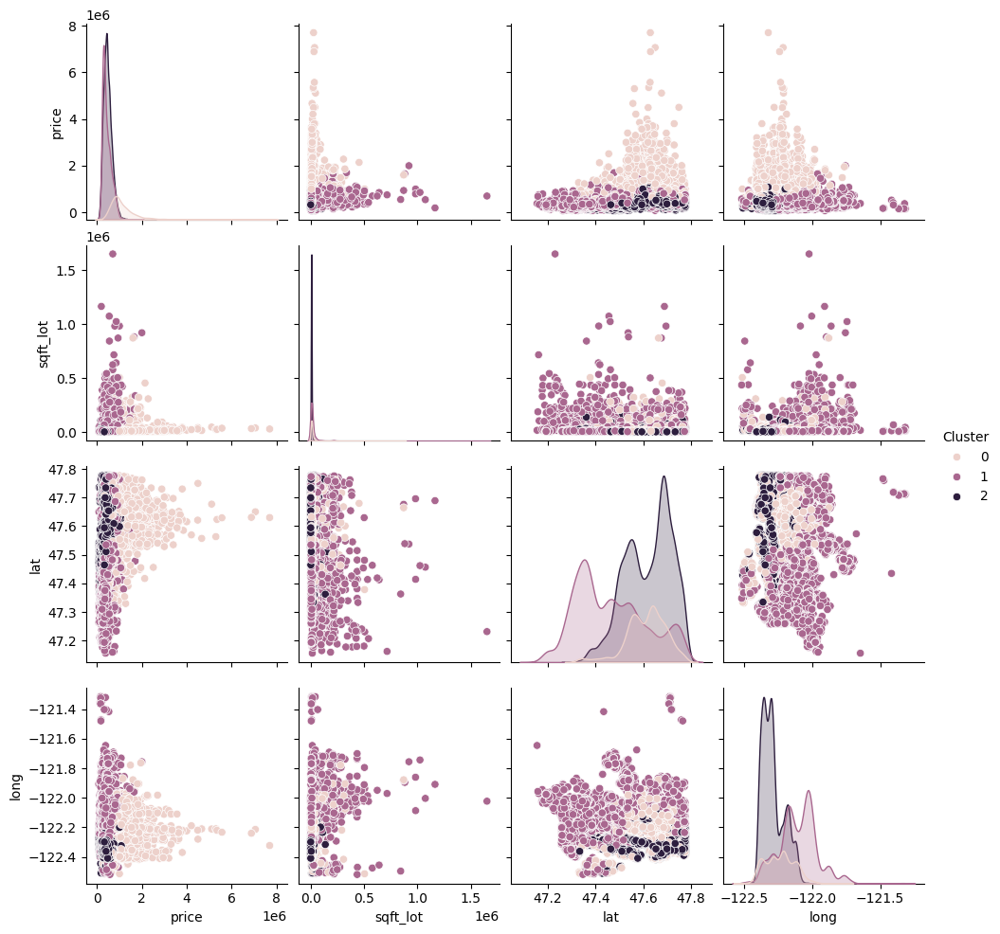

In [ ]:
# Pairplot visualization
sns.pairplot(df, hue='Cluster', vars=['price', 'sqft_lot', 'lat', 'long'])
plt.show()


**Map Visualization**

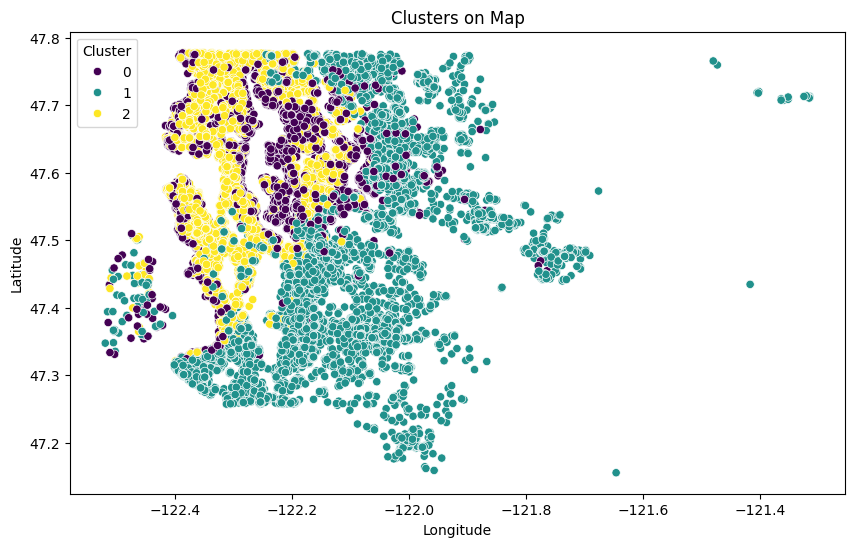

In [ ]:
# Plot clusters on a map (if geographical data is significant)
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['long'], y=df['lat'], hue=df['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


In [ ]:
from sklearn.decomposition import PCA

# Dimensionality reduction using PCA
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# Perform K-means clustering with the chosen k (let's assume k=3 from the previous analysis)
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
df['Cluster'] = clusters

# Silhouette Analysis
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')

# Cluster profiling
cluster_profile = df.groupby('Cluster')[features].mean()
print(cluster_profile)

# Plotting the centroids
centroids = kmeans.cluster_centers_
centroids_df = pd.DataFrame(scaler.inverse_transform(pca.inverse_transform(centroids)), columns=features)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.40954614437768144
                price  bedrooms  bathrooms      sqft_lot   floors  waterfront  \
Cluster                                                                         
0        4.491165e+05  3.057869   1.688718   7429.072114  1.28628    0.000989   
1        4.226747e+05  3.448364   2.258820  25419.598461  1.58499    0.000000   
2        1.034796e+06  4.060933   2.973173  14359.835535  1.87072    0.041251   

             view  condition     yr_built  yr_renovated        lat  \
Cluster                                                              
0        0.121080   3.523395  1954.650411     81.237214  47.611384   
1        0.076331   3.293778  1987.373445     35.834124  47.464017   
2        0.874899   3.341871  1981.180102    195.101645  47.621979   

               long  nearest_station_distance_km      density  commute_time  \
Cluster                                                                       
0       -122.293765                  7573.77233

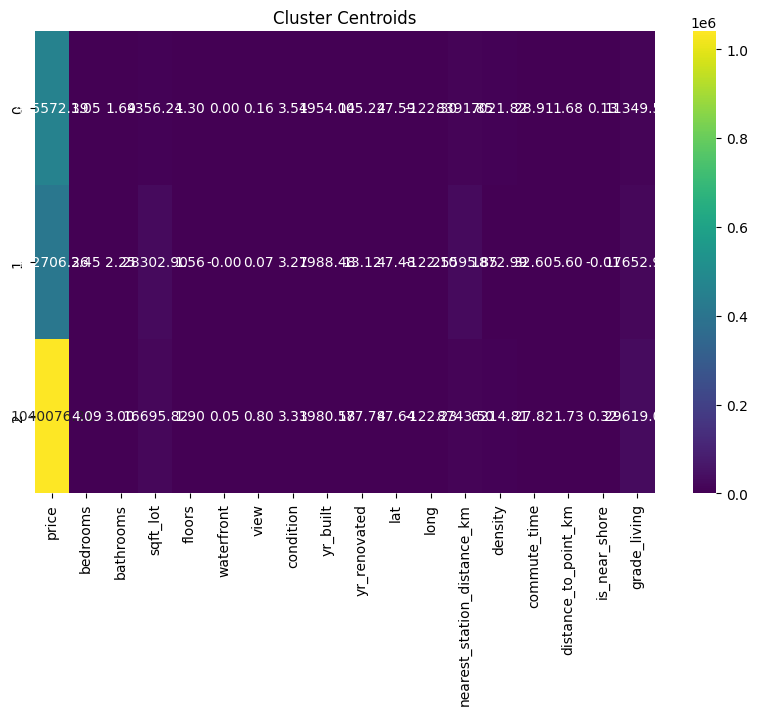

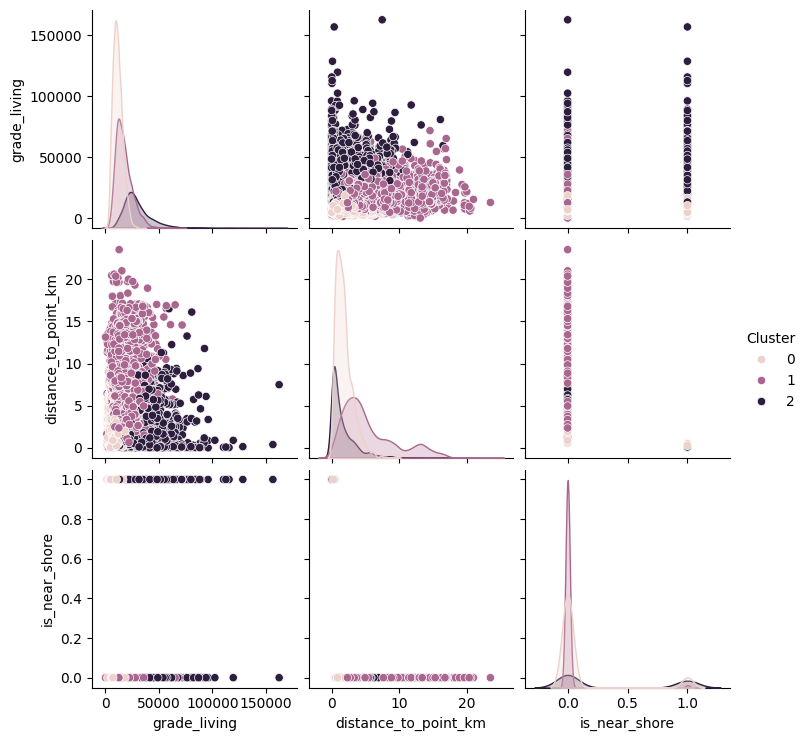

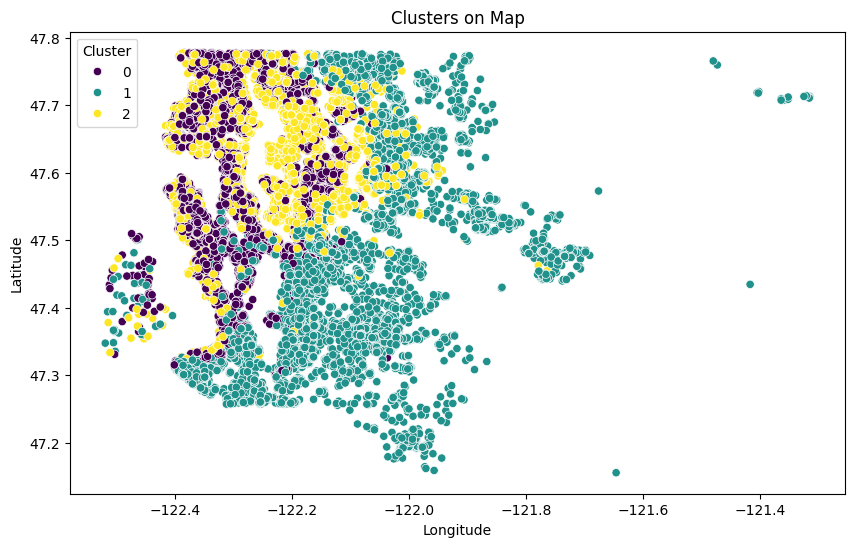

In [ ]:
# Plotting the centroids
centroids = kmeans.cluster_centers_
centroids_df = pd.DataFrame(scaler.inverse_transform(pca.inverse_transform(centroids)), columns=features)

# Visualize the centroids
plt.figure(figsize=(10, 6))
sns.heatmap(centroids_df, annot=True, cmap='viridis', fmt='.2f')
plt.title('Cluster Centroids')
plt.show()

# Pairplot visualization
sns.pairplot(df, hue='Cluster', vars=['grade_living', 'distance_to_point_km', 'is_near_shore'])
plt.show()

# Plot clusters on a map (if geographical data is significant)
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['long'], y=df['lat'], hue=df['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [ ]:
data = df.copy()

**Principal Component Analysis (PCA)**

In [ ]:
# Features Scaller
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[features])

# PCA
pca = PCA(n_components=2)
pca.fit(data_features_scaled)

# PCA components
pca_components = pd.DataFrame(pca.components_, columns=features)
print(pca_components)


      price  bedrooms  bathrooms  sqft_lot    floors  waterfront      view  \
0 -0.061379  0.102378   0.173713  0.157366  0.119164   -0.029508 -0.048138   
1  0.462197  0.283003   0.423156  0.037697  0.275740    0.149940  0.246740   

   condition  yr_built  yr_renovated       lat      long  \
0  -0.110987  0.313834     -0.067766 -0.242925  0.384493   
1  -0.058853  0.161608      0.069995  0.156736  0.021513   

   nearest_station_distance_km   density  commute_time  distance_to_point_km  \
0                     0.435919 -0.394380      0.297574              0.341428   
1                    -0.117080  0.052059     -0.171639             -0.094083   

   is_near_shore  grade_living  
0      -0.142995      0.141564  
1       0.205568      0.458158  


**Feature Importance from Random Forest (Supervised Learning Insight)**

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Rastgele Orman modeli ile özellik önemini belirleme
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(data_features_scaled, data['Cluster'])

# Özellik önemini alma
feature_importances = pd.DataFrame(rf.feature_importances_, index=features, columns=['importance'])
feature_importances = feature_importances.sort_values('importance', ascending=False)
print(feature_importances)


                             importance
grade_living                   0.433864
bathrooms                      0.190994
price                          0.121647
density                        0.042151
sqft_lot                       0.040884
nearest_station_distance_km    0.037452
distance_to_point_km           0.022911
long                           0.022378
lat                            0.016368
commute_time                   0.013430
view                           0.011262
floors                         0.011097
bedrooms                       0.010698
yr_renovated                   0.010088
yr_built                       0.007815
waterfront                     0.003228
condition                      0.002662
is_near_shore                  0.001072


**Cluster Profiling**

In [ ]:
# Cluster profiling
cluster_profile = data.groupby('Cluster')[features].mean()
print(cluster_profile)


                price  bedrooms  bathrooms      sqft_lot    floors  \
Cluster                                                              
0        4.491495e+05  3.057852   1.688959   7428.402591  1.286590   
1        4.226811e+05  3.447780   2.258725  25421.228637  1.585065   
2        1.035001e+06  4.062854   2.973564  14366.826814  1.870111   

         waterfront      view  condition     yr_built  yr_renovated  \
Cluster                                                               
0          0.000989  0.121044   3.523240  1954.661294     81.408623   
1          0.000000  0.076341   3.293816  1987.377085     35.838722   
2          0.041273  0.875371   3.342056  1981.165902    194.673591   

               lat        long  nearest_station_distance_km      density  \
Cluster                                                                    
0        47.611405 -122.293777                  7572.372774  6908.497033   
1        47.464014 -122.100460                 26388.199303  2176

**Correlation Analysis**

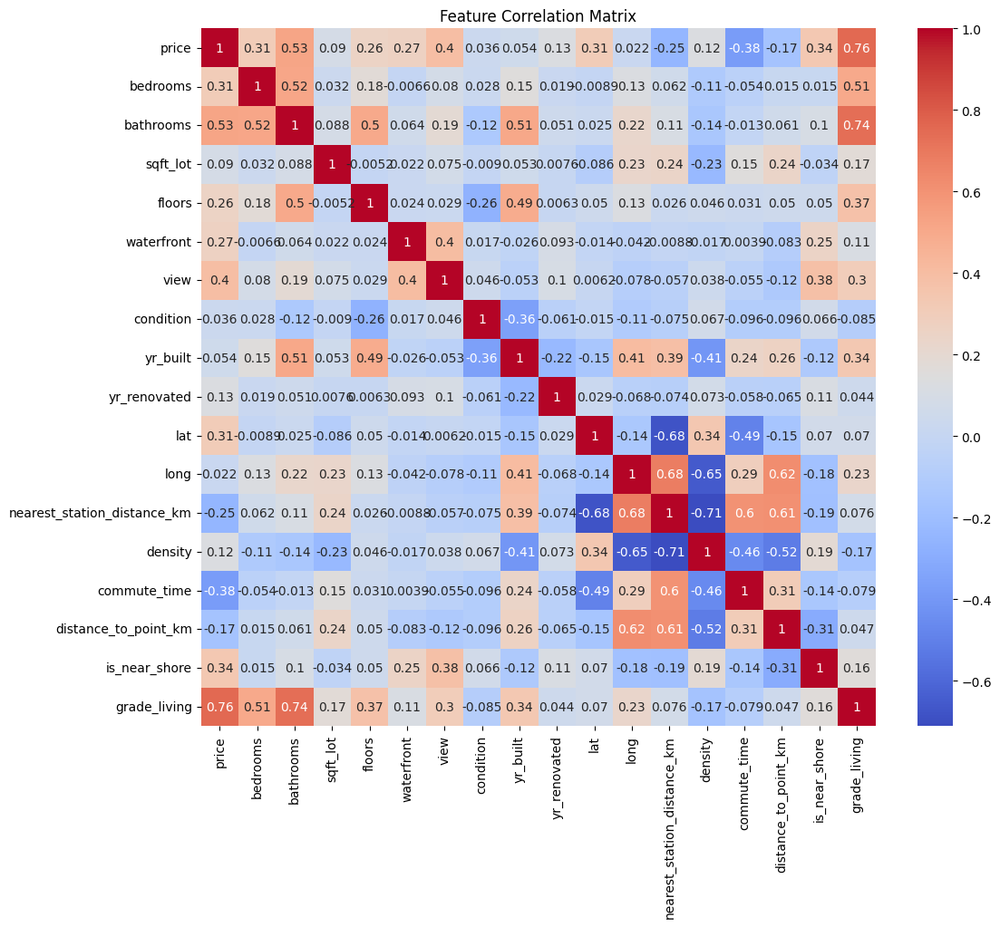

In [ ]:

# Correlation matrix
correlation_matrix = data[features].corr()

# Visualizing Correlation
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Feature Correlation Matrix')
plt.show()


In [ ]:

# Select the most important features based on Random Forest importance
important_features = [
    'nearest_station_distance_km', 'grade_living', 'density', 'commute_time',
    'price', 'long', 'bathrooms', 'yr_built', 'lat', 'distance_to_point_km'
]

data_features = data[important_features]
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data_features)

**Dimensionality Reduction Using PCA**

In [ ]:
# Dimensionality reduction using PCA
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)


**Perform K-means Clustering**

In [ ]:
# Perform K-means clustering with the chosen k (let's assume k=3 from the previous analysis)
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


** Silhouette Analysis**

In [ ]:
# Silhouette Analysis
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')


Silhouette Score: 0.42697513052854963


**Cluster Profiling**

In [ ]:
# Cluster profiling
cluster_profile = data.groupby('Cluster')[important_features].mean()
print(cluster_profile)


         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
0                        6724.333422  11926.769163  7262.925684     28.594974   
1                       26826.178937  16036.885018  2232.744500     33.157373   
2                       11575.871371  31559.067655  4585.121294     27.729757   

                price        long  bathrooms     yr_built        lat  \
Cluster                                                                
0        4.714450e+05 -122.300792   1.752898  1954.932600  47.619523   
1        3.914139e+05 -122.110167   2.165597  1985.040335  47.448495   
2        1.036055e+06 -122.186922   3.011523  1986.596496  47.625084   

         distance_to_point_km  
Cluster                        
0                    1.672400  
1                    5.389359  
2                    2.361922  


**Visualize the Cluster Centroids**

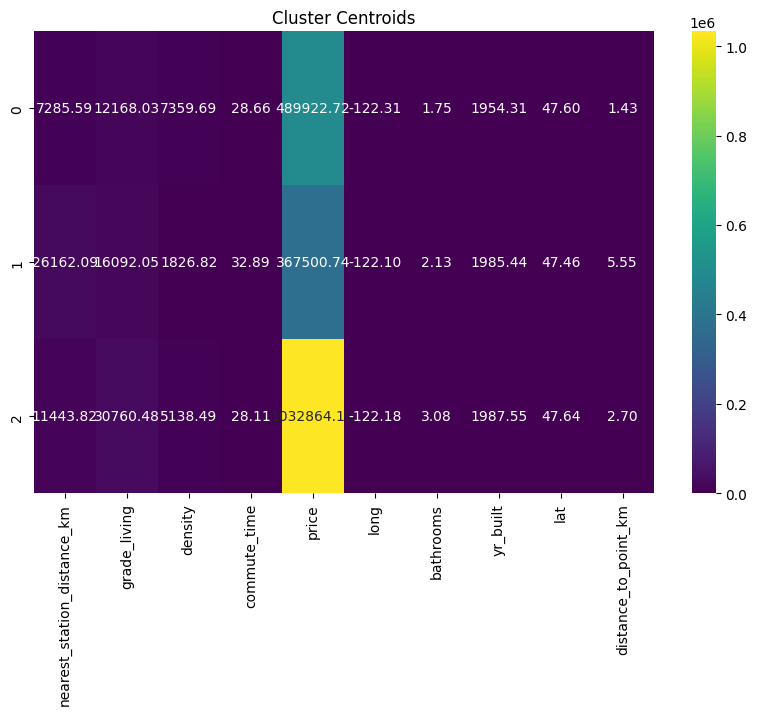

In [ ]:
# Plotting the centroids
centroids = kmeans.cluster_centers_
centroids_df = pd.DataFrame(scaler.inverse_transform(pca.inverse_transform(centroids)), columns=important_features)

# Visualize the centroids
plt.figure(figsize=(10, 6))
sns.heatmap(centroids_df, annot=True, cmap='viridis', fmt='.2f')
plt.title('Cluster Centroids')
plt.show()


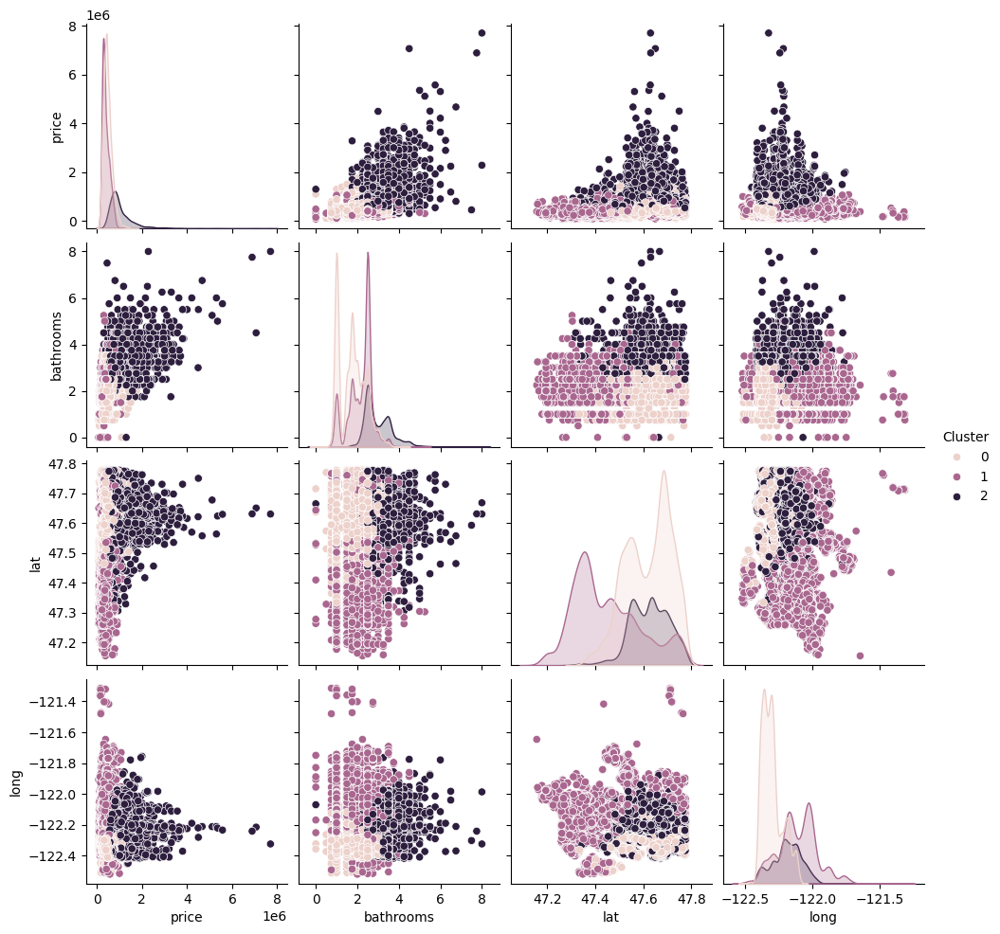

In [ ]:
# Pairplot visualization
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'lat', 'long'])
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.4267297564489303
         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
0                        6522.363105  11906.061703  7304.322357     28.539751   
1                       12236.645894  31168.478109  4349.475607     27.989792   
2                       26917.151097  15594.765427  2315.744236     33.207250   

                price        long  bathrooms     yr_built        lat  
Cluster                                                               
0        4.739973e+05 -122.300069   1.748838  1954.601602  47.623917  
1        1.008623e+06 -122.177616   2.993683  1987.408556  47.626318  
2        3.795715e+05 -122.117075   2.139744  1984.376383  47.438671  


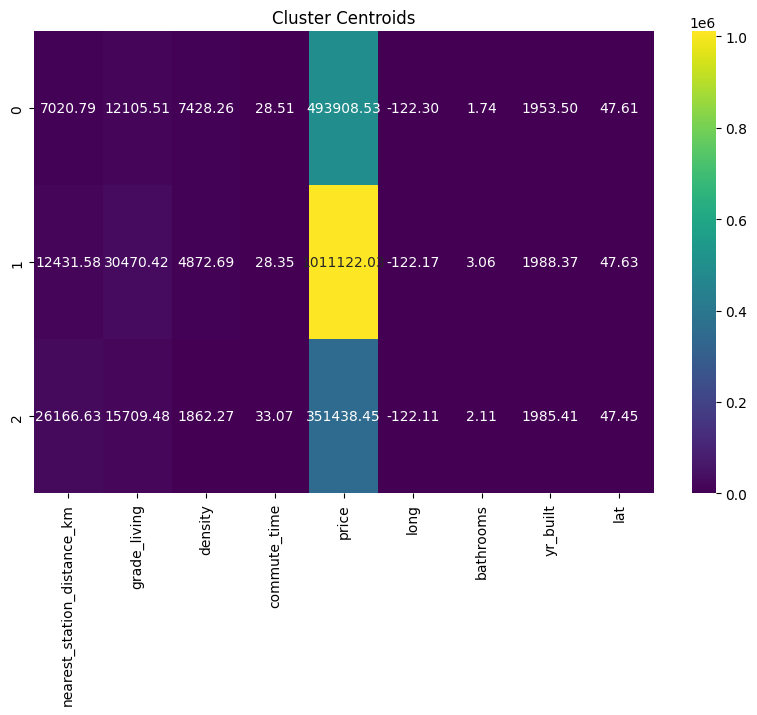

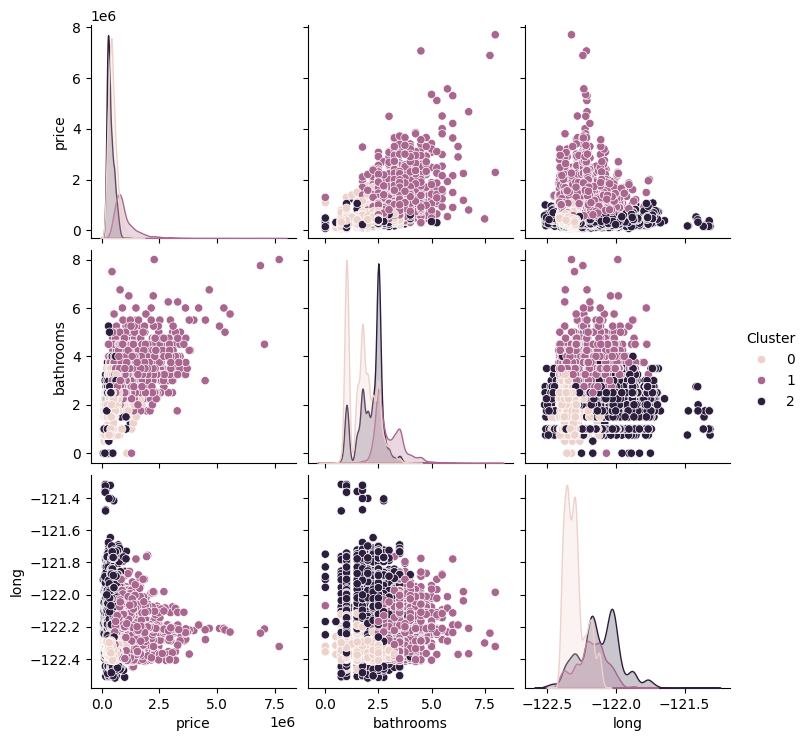

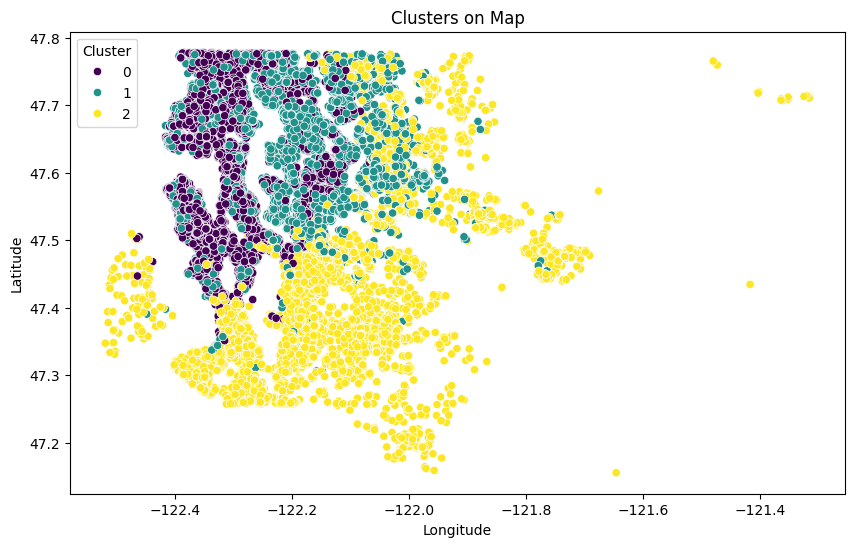

In [ ]:
# Selecting top features based on importance
# Based on the feature importance provided earlier
top_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardizing the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[top_features])

# Dimensionality reduction using PCA (if needed)
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# Perform K-means clustering with k=3
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analysis
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')

# Cluster profiling
cluster_profile = data.groupby('Cluster')[top_features].mean()
print(cluster_profile)

# Plotting the centroids
centroids = kmeans.cluster_centers_
centroids_df = pd.DataFrame(scaler.inverse_transform(pca.inverse_transform(centroids)), columns=top_features)

# Visualize the centroids
plt.figure(figsize=(10, 6))
sns.heatmap(centroids_df, annot=True, cmap='viridis', fmt='.2f')
plt.title('Cluster Centroids')
plt.show()

# Pairplot visualization
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'long'])
plt.show()

# Plot clusters on a map
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['long'], y=data['lat'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


Silhouette Score: 0.36519766264973597
         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
-1                      20961.606905  75004.509091  4385.527273     28.330909   
 0                      14613.435372  16590.749547  5030.801866     30.060991   
 1                      15323.447974  68578.333333  2978.000000     28.883333   
 2                      72446.901862   5460.000000    89.000000     34.200000   
 3                      72473.579050   8096.666667    79.166667     34.233333   

                price        long  bathrooms     yr_built        lat  
Cluster                                                               
-1       2.745348e+06 -122.067418   4.650000  1982.854545  47.585422  
 0       5.342502e+05 -122.214721   2.107922  1970.974421  47.559939  
 1       1.932500e+06 -122.149500   4.958333  1988.833333  47.549983  
 2       1.508000e+05 -121.343000   1.0

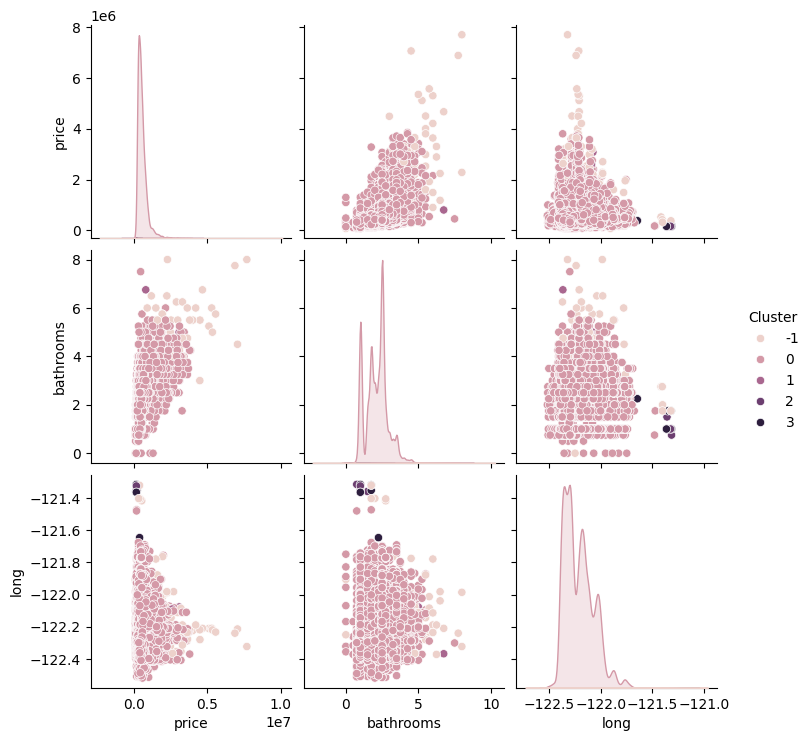

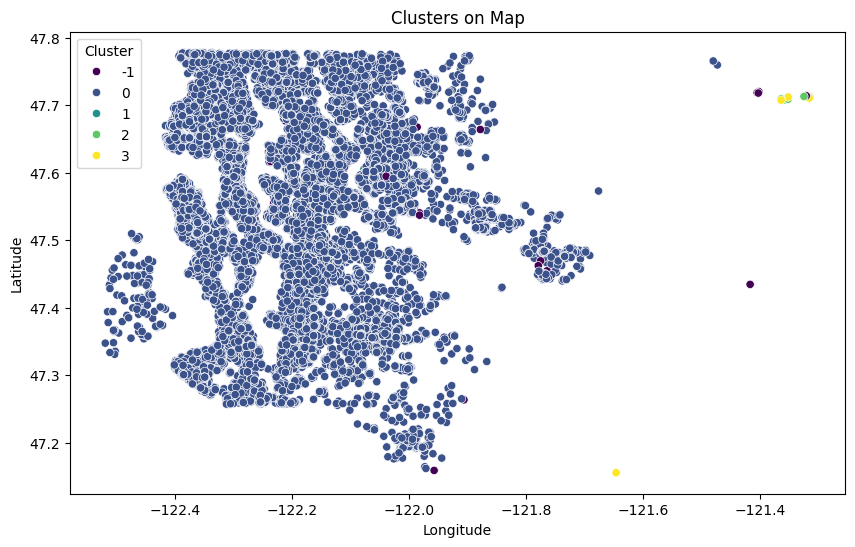

In [ ]:

from sklearn.cluster import KMeans, DBSCAN
# Selecting refined features based on importance and new features
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardizing the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# Dimensionality reduction using PCA (optional)
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.5, min_samples=5)
clusters = dbscan.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analysis
if len(set(clusters)) > 1:
    silhouette_avg = silhouette_score(data_features_pca, clusters)
    print(f'Silhouette Score: {silhouette_avg}')
else:
    print("Silhouette Score cannot be computed with only one cluster.")

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# Plotting the centroids
# For DBSCAN, centroids are not meaningful as it does not compute cluster centers

# Pairplot visualization
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'long'])
plt.show()

# Plot clusters on a map
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['long'], y=data['lat'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


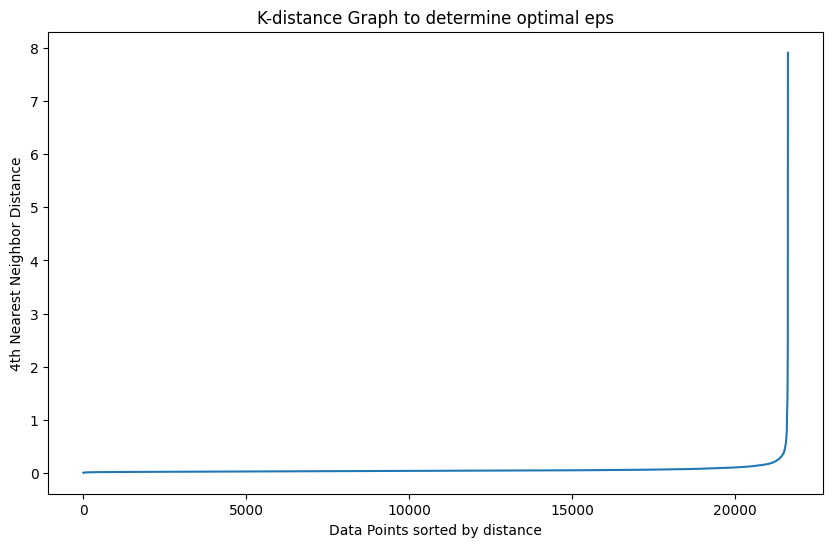

Silhouette Score: -0.5083984023962689
         nearest_station_distance_km  grade_living       density  \
Cluster                                                            
-1                      17043.333163  24635.335324   5175.207415   
 0                      12889.358155   6409.360000   5165.112000   
 1                       7232.055791  12607.745897   6221.061692   
 2                      22944.174830  16353.321469   3034.370235   
 3                      16860.051498   8932.222222   5058.222222   
...                              ...           ...           ...   
 332                    30117.354980  16307.250000   1645.500000   
 333                    23419.031031  20247.500000   3095.000000   
 334                     1597.511027  14738.000000  14693.500000   
 335                     1713.961638  14662.500000  13239.750000   
 336                    35681.503160  10415.000000    393.750000   

         commute_time          price        long  bathrooms     yr_built  \
C

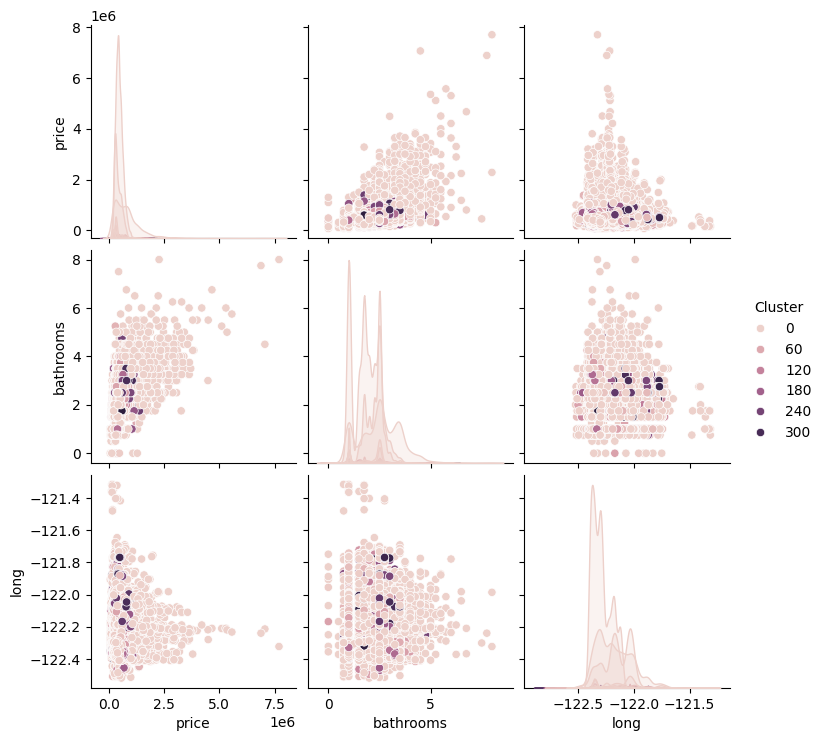

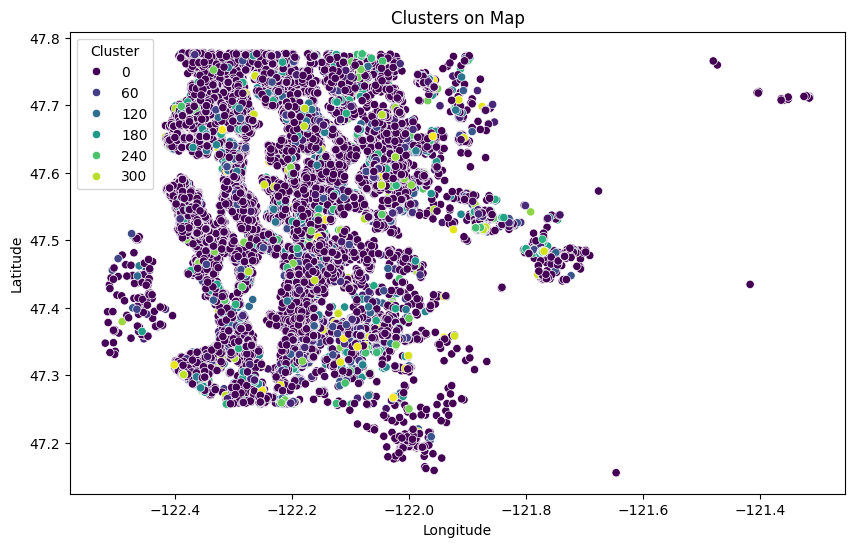

In [ ]:
# Selecting refined features based on importance
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardizing the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# Dimensionality reduction using PCA (optional)
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# Finding optimal parameters for DBSCAN
from sklearn.neighbors import NearestNeighbors

# Use NearestNeighbors to find the optimal eps
neighbors = NearestNeighbors(n_neighbors=5)
neighbors_fit = neighbors.fit(data_features_pca)
distances, indices = neighbors_fit.kneighbors(data_features_pca)
distances = np.sort(distances[:, 4], axis=0)

plt.figure(figsize=(10, 6))
plt.plot(distances)
plt.title('K-distance Graph to determine optimal eps')
plt.xlabel('Data Points sorted by distance')
plt.ylabel('4th Nearest Neighbor Distance')
plt.show()

# Based on the graph, choose an appropriate value for eps
eps_value = 0.05  # Adjust this based on the K-distance graph

# Perform DBSCAN clustering
dbscan = DBSCAN(eps=eps_value, min_samples=5)
clusters = dbscan.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analysis
# Calculate silhouette score only if there are more than 1 cluster
unique_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
if unique_clusters > 1:
    silhouette_avg = silhouette_score(data_features_pca, clusters)
    print(f'Silhouette Score: {silhouette_avg}')
else:
    print("Silhouette Score cannot be computed with only one cluster.")

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# Pairplot visualization
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'long'])
plt.show()

# Plot clusters on a map
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['long'], y=data['lat'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


Silhouette Score: 0.3651976626497361
         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
-1                      20961.606905  75004.509091  4385.527273     28.330909   
 0                      14613.435372  16590.749547  5030.801866     30.060991   
 1                      15323.447974  68578.333333  2978.000000     28.883333   
 2                      72446.901862   5460.000000    89.000000     34.200000   
 3                      72473.579050   8096.666667    79.166667     34.233333   

                price        long  bathrooms     yr_built        lat  
Cluster                                                               
-1       2.745348e+06 -122.067418   4.650000  1982.854545  47.585422  
 0       5.342502e+05 -122.214721   2.107922  1970.974421  47.559939  
 1       1.932500e+06 -122.149500   4.958333  1988.833333  47.549983  
 2       1.508000e+05 -121.343000   1.05

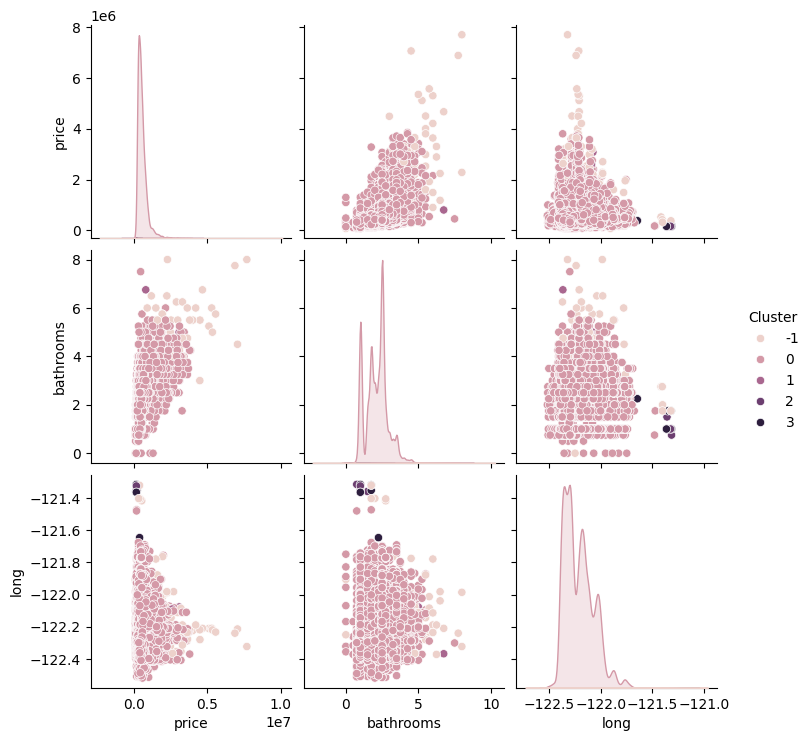

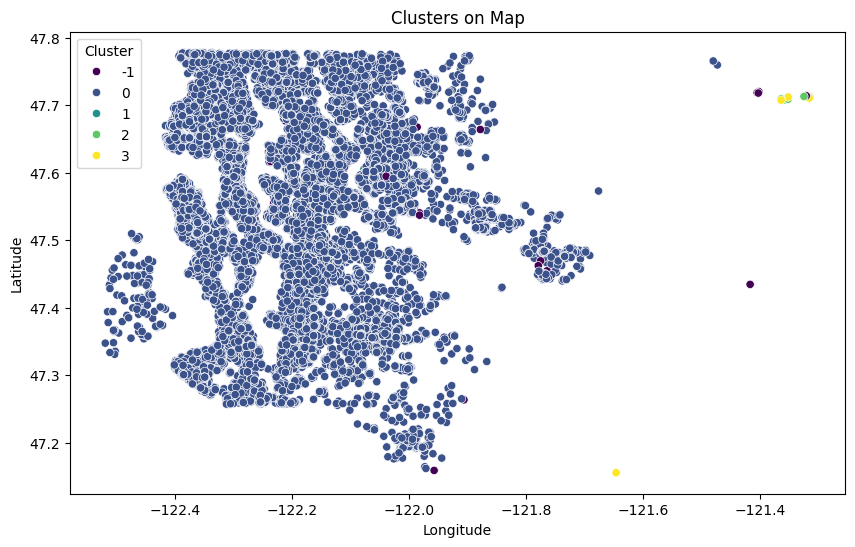

In [ ]:
# Selecting refined features based on importance
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardizing the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# Dimensionality reduction using PCA (optional)
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# Perform DBSCAN clustering
eps_value = 0.5  # Based on the K-distance graph
dbscan = DBSCAN(eps=eps_value, min_samples=5)
clusters = dbscan.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analysis
unique_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
if unique_clusters > 1:
    silhouette_avg = silhouette_score(data_features_pca, clusters)
    print(f'Silhouette Score: {silhouette_avg}')
else:
    print("Silhouette Score cannot be computed with only one cluster or if all points are noise.")

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# Pairplot visualization
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'long'])
plt.show()

# Plot clusters on a map
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['long'], y=data['lat'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

Silhouette Score: 0.732646008228519
         nearest_station_distance_km   grade_living      density  \
Cluster                                                            
-1                      11972.771346  100584.000000  5660.100000   
 0                      14663.923752   16651.600222  5025.892574   
 1                       6723.155519   87360.000000  3558.333333   

         commute_time         price        long  bathrooms     yr_built  \
Cluster                                                                   
-1          26.460000  3.956260e+06 -122.162750   5.687500  1976.700000   
 0          30.063061  5.360063e+05 -122.213933   2.110425  1970.993515   
 1          25.200000  3.838500e+06 -122.253500   5.791667  1993.833333   

               lat  
Cluster             
-1       47.614280  
 0       47.559977  
 1       47.650417  


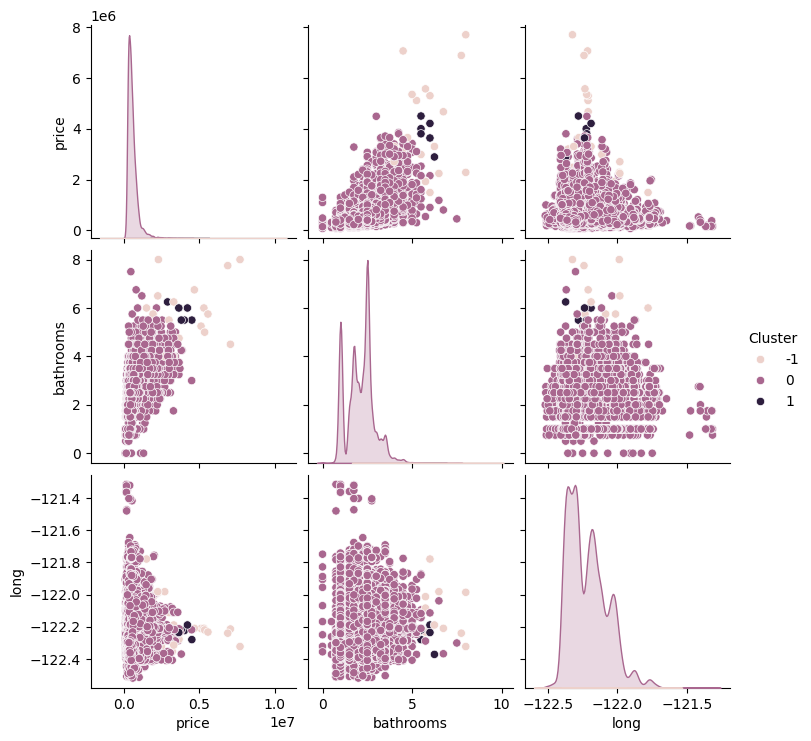

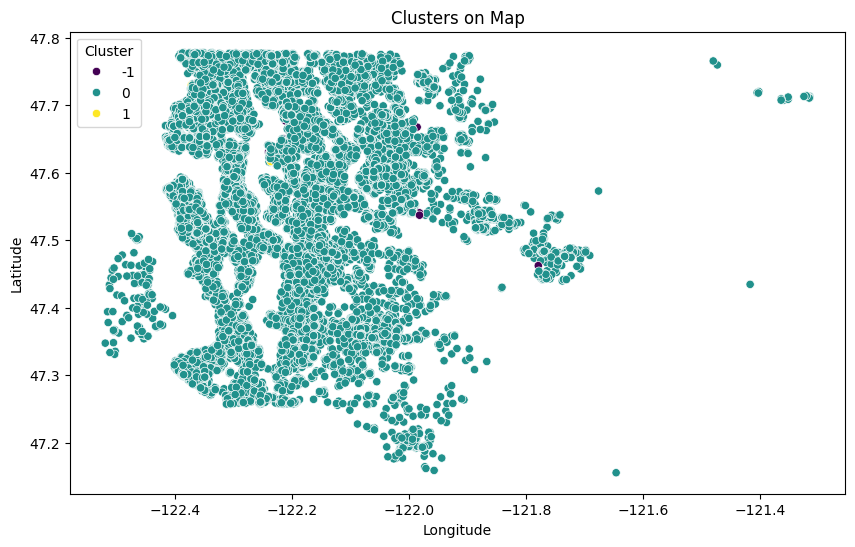

In [ ]:
# Perform DBSCAN clustering with eps = 1
eps_value = 1.0  # Trying a larger value based on the K-distance graph
dbscan = DBSCAN(eps=eps_value, min_samples=5)
clusters = dbscan.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analysis
unique_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
if unique_clusters > 1:
    silhouette_avg = silhouette_score(data_features_pca, clusters)
    print(f'Silhouette Score: {silhouette_avg}')
else:
    print("Silhouette Score cannot be computed with only one cluster or if all points are noise.")

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# Pairplot visualization
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'long'])
plt.show()

# Plot clusters on a map
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['long'], y=data['lat'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


Silhouette Score: 0.7326460082285192
         nearest_station_distance_km   grade_living      density  \
Cluster                                                            
-1                      11972.771346  100584.000000  5660.100000   
 0                      14663.923752   16651.600222  5025.892574   
 1                       6723.155519   87360.000000  3558.333333   

         commute_time         price        long  bathrooms     yr_built  \
Cluster                                                                   
-1          26.460000  3.956260e+06 -122.162750   5.687500  1976.700000   
 0          30.063061  5.360063e+05 -122.213933   2.110425  1970.993515   
 1          25.200000  3.838500e+06 -122.253500   5.791667  1993.833333   

               lat  
Cluster             
-1       47.614280  
 0       47.559977  
 1       47.650417  


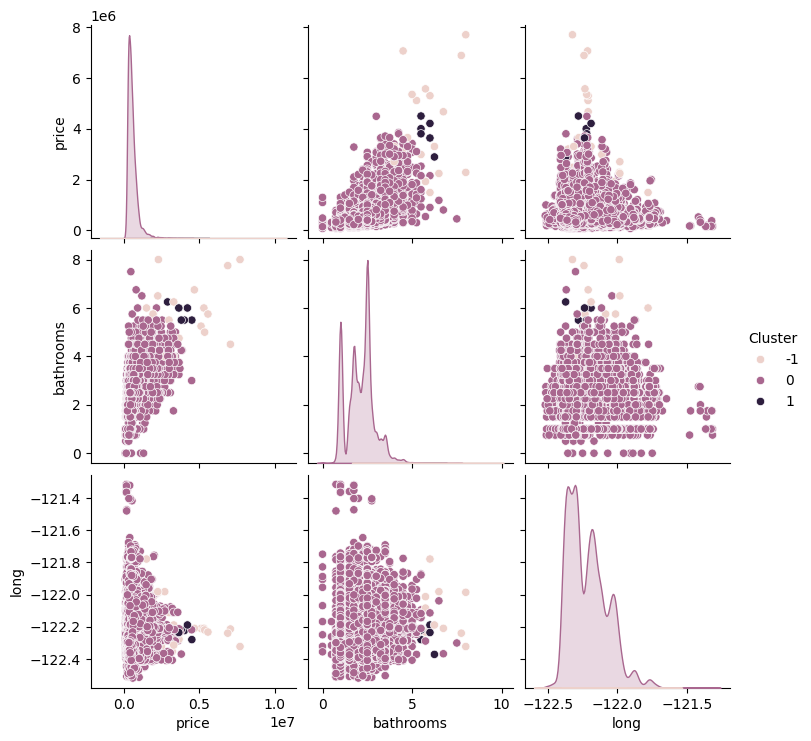

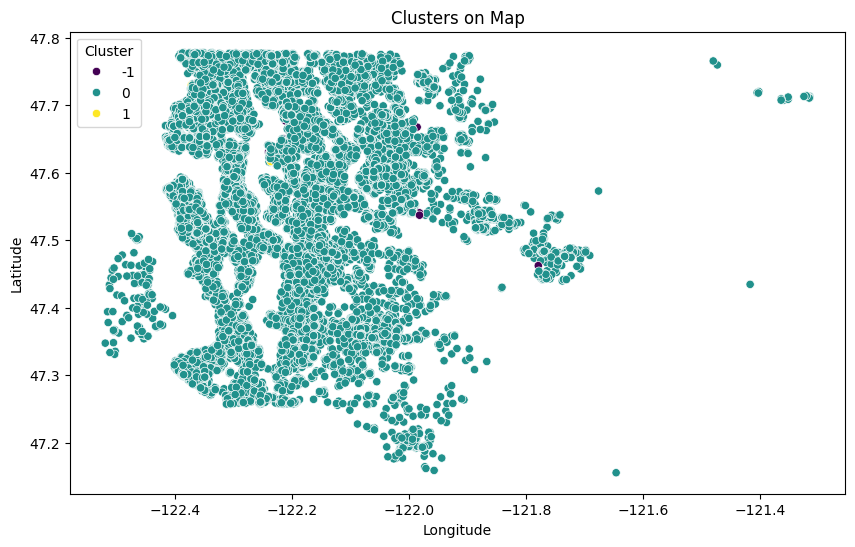

In [ ]:
# Selecting refined features based on importance
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardizing the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# Dimensionality reduction using PCA (optional)
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# Perform DBSCAN clustering with eps=1.0
eps_value = 1.0  # Based on the K-distance graph
dbscan = DBSCAN(eps=eps_value, min_samples=5)
clusters = dbscan.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analysis
unique_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
if unique_clusters > 1:
    silhouette_avg = silhouette_score(data_features_pca, clusters)
    print(f'Silhouette Score: {silhouette_avg}')
else:
    print("Silhouette Score cannot be computed with only one cluster or if all points are noise.")

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# Visualizing the clusters
# Pairplot visualization
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'long'])
plt.show()

# Plot clusters on a map
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['long'], y=data['lat'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters on Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


******

Yuksek Siluet Score

Silhouette Score: 0.7326460082285189
         nearest_station_distance_km   grade_living      density  \
Cluster                                                            
-1                      11972.771346  100584.000000  5660.100000   
 0                      14663.923752   16651.600222  5025.892574   
 1                       6723.155519   87360.000000  3558.333333   

         commute_time        long         price  bathrooms     yr_built  \
Cluster                                                                   
-1          26.460000 -122.162750  3.956260e+06   5.687500  1976.700000   
 0          30.063061 -122.213933  5.360063e+05   2.110425  1970.993515   
 1          25.200000 -122.253500  3.838500e+06   5.791667  1993.833333   

               lat  
Cluster             
-1       47.614280  
 0       47.559977  
 1       47.650417  


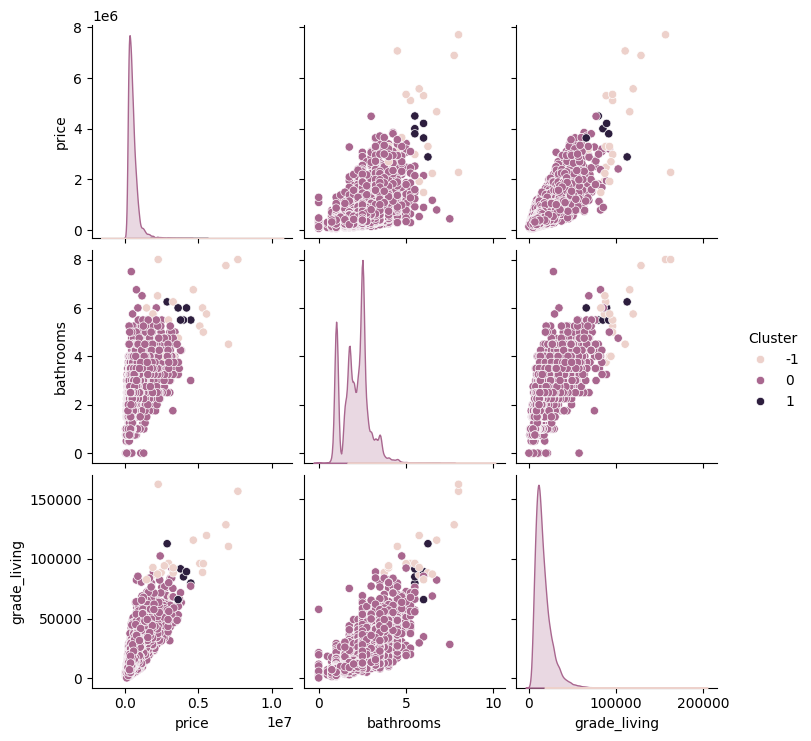

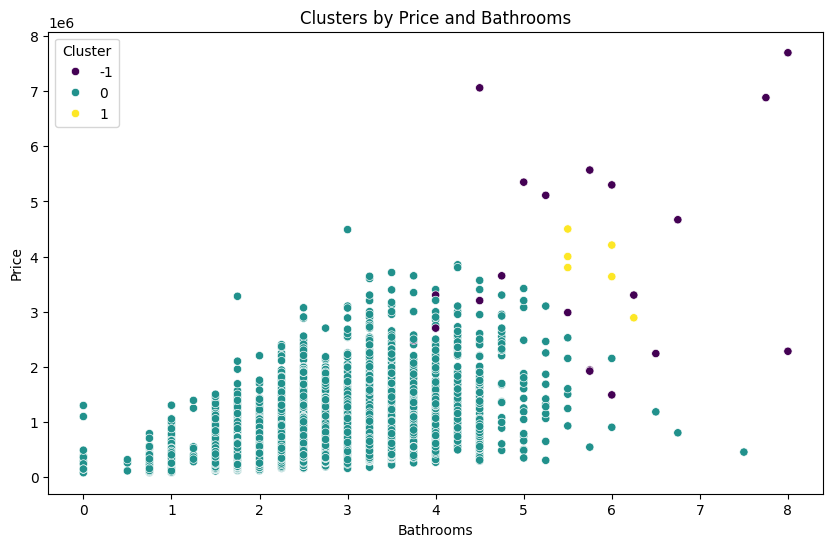

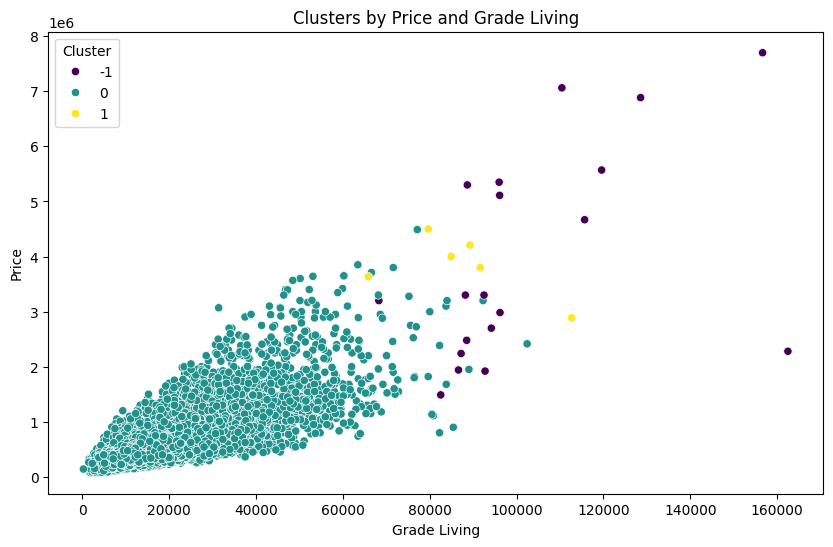

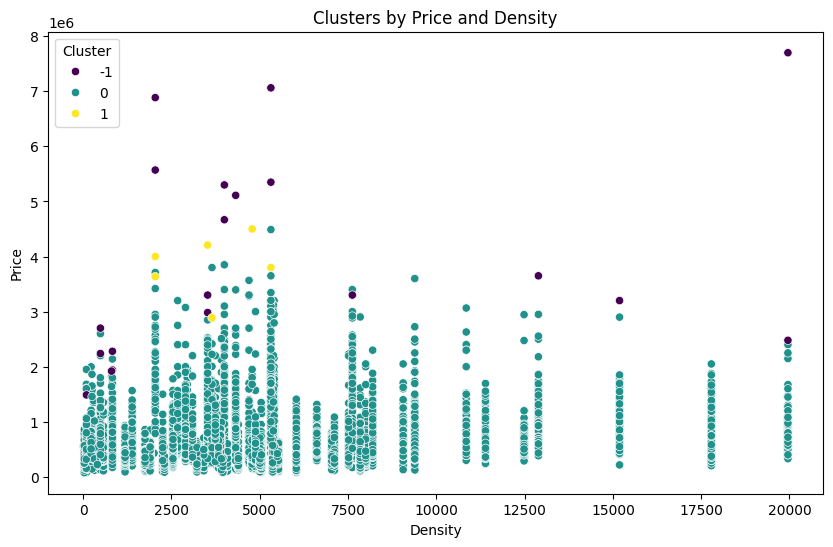

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN



# Önemli sütunları seçin
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'long', 'price', 'bathrooms', 'yr_built', 'lat'
]

# Seçilen özellikleri standardize edin
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# PCA kullanarak boyut azaltma (isteğe bağlı)
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# DBSCAN kümeleme uygulaması
eps_value = 1.0  # K-distance grafiğine dayalı olarak
dbscan = DBSCAN(eps=eps_value, min_samples=5)
clusters = dbscan.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analizi
unique_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
if unique_clusters > 1:
    silhouette_avg = silhouette_score(data_features_pca, clusters)
    print(f'Silhouette Score: {silhouette_avg}')
else:
    print("Silhouette Score cannot be computed with only one cluster or if all points are noise.")

# Küme profilleme
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# Görselleştirme
# Çiftli dağılım grafikleri (pairplot)
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'grade_living'])
plt.show()

# Kümeleri fiyat ve banyolar üzerinden görselleştirme
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['bathrooms'], y=data['price'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters by Price and Bathrooms')
plt.xlabel('Bathrooms')
plt.ylabel('Price')
plt.show()

# Kümeleri yaşam kalitesi (grade_living) ve fiyat üzerinden görselleştirme
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['grade_living'], y=data['price'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters by Price and Grade Living')
plt.xlabel('Grade Living')
plt.ylabel('Price')
plt.show()

# Kümeleri yoğunluk (density) ve fiyat üzerinden görselleştirme
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['density'], y=data['price'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters by Price and Density')
plt.xlabel('Density')
plt.ylabel('Price')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.4267297564489303
         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
0                        6522.363105  11906.061703  7304.322357     28.539751   
1                       12236.645894  31168.478109  4349.475607     27.989792   
2                       26917.151097  15594.765427  2315.744236     33.207250   

                price        long  bathrooms     yr_built        lat  
Cluster                                                               
0        4.739973e+05 -122.300069   1.748838  1954.601602  47.623917  
1        1.008623e+06 -122.177616   2.993683  1987.408556  47.626318  
2        3.795715e+05 -122.117075   2.139744  1984.376383  47.438671  


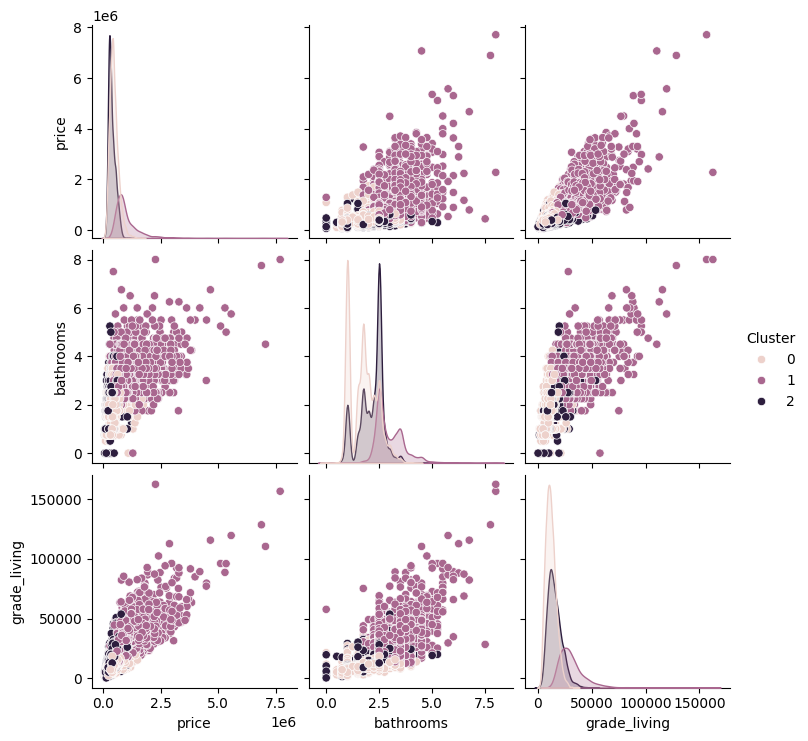

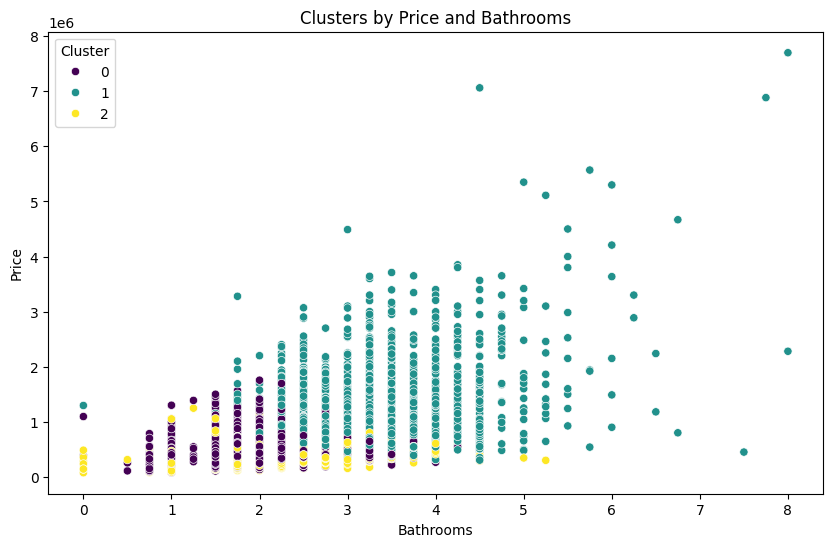

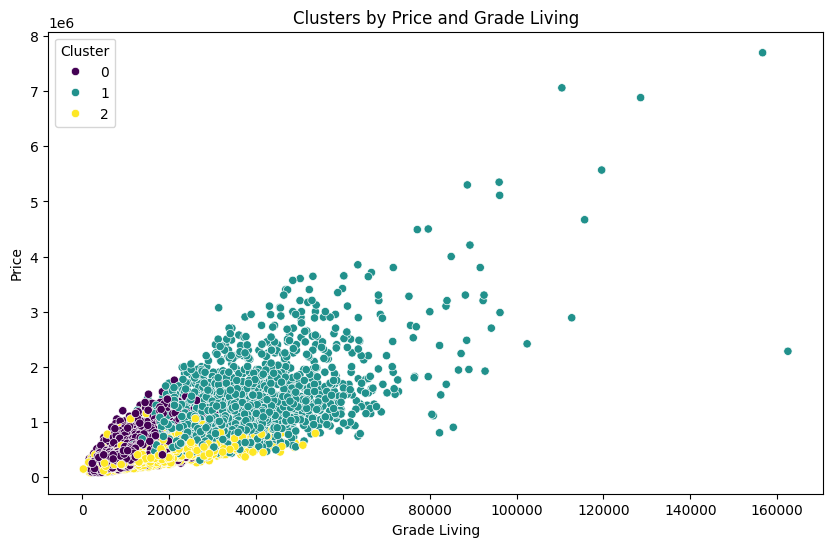

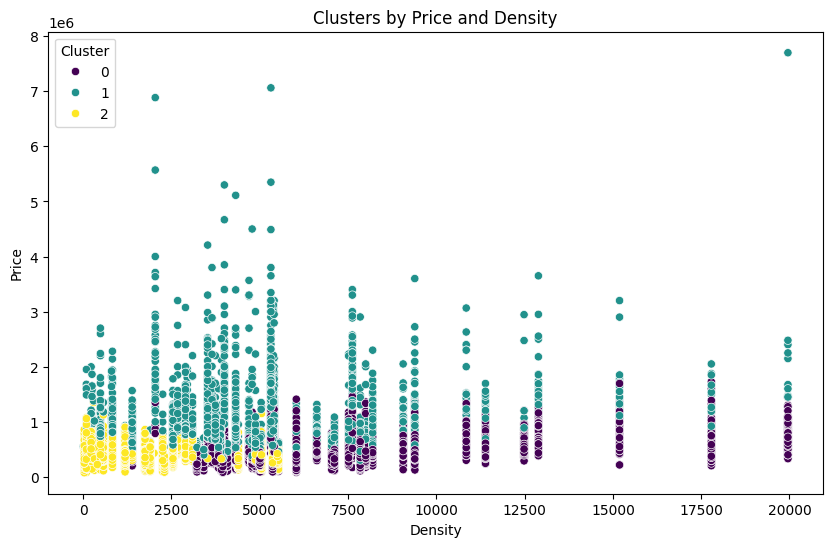

In [ ]:
# Önemli sütunları seçin
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Seçilen özellikleri standardize edin
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# PCA kullanarak boyut azaltma (isteğe bağlı)
pca = PCA(n_components=2)
data_features_pca = pca.fit_transform(data_features_scaled)

# K-means kümeleme uygulaması (örneğin k=3)
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette Analizi
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')

# Küme profilleme
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# Görselleştirme
# Çiftli dağılım grafikleri (pairplot)
sns.pairplot(data, hue='Cluster', vars=['price', 'bathrooms', 'grade_living'])
plt.show()

# Kümeleri fiyat ve banyolar üzerinden görselleştirme
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['bathrooms'], y=data['price'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters by Price and Bathrooms')
plt.xlabel('Bathrooms')
plt.ylabel('Price')
plt.show()

# Kümeleri yaşam kalitesi (grade_living) ve fiyat üzerinden görselleştirme
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['grade_living'], y=data['price'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters by Price and Grade Living')
plt.xlabel('Grade Living')
plt.ylabel('Price')
plt.show()

# Kümeleri yoğunluk (density) ve fiyat üzerinden görselleştirme
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data['density'], y=data['price'], hue=data['Cluster'], palette='viridis')
plt.title('Clusters by Price and Density')
plt.xlabel('Density')
plt.ylabel('Price')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.35881027151968015
         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
0                        6512.261787  11893.288090  7297.790516     28.538264   
1                       12452.800140  30945.549148  4271.947932     28.080243   
2                       27001.965890  15492.248581  2344.745609     33.231140   

                 price        long  bathrooms     yr_built        lat  
Cluster                                                                
0        474300.273933 -122.299543   1.746683  1954.604396  47.624989  
1        998750.673479 -122.173696   2.981204  1987.578345  47.627276  
2        375189.499189 -122.119342   2.135943  1984.183734  47.434112  


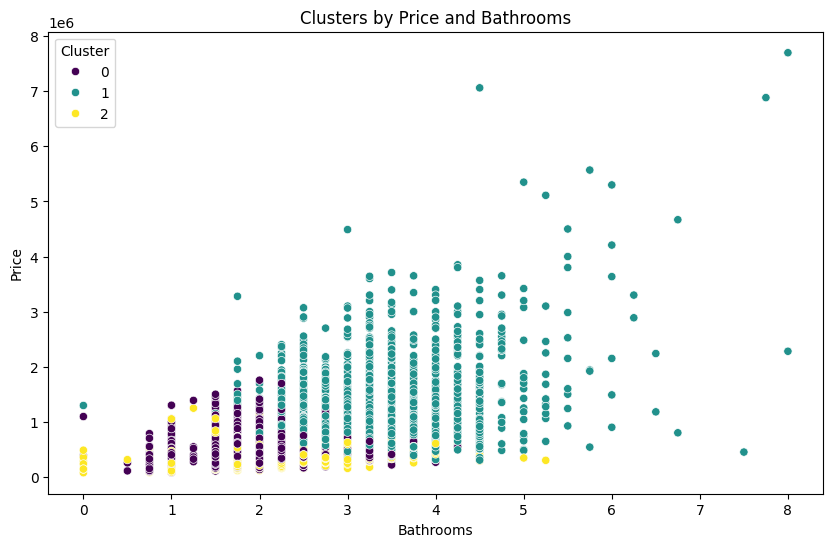

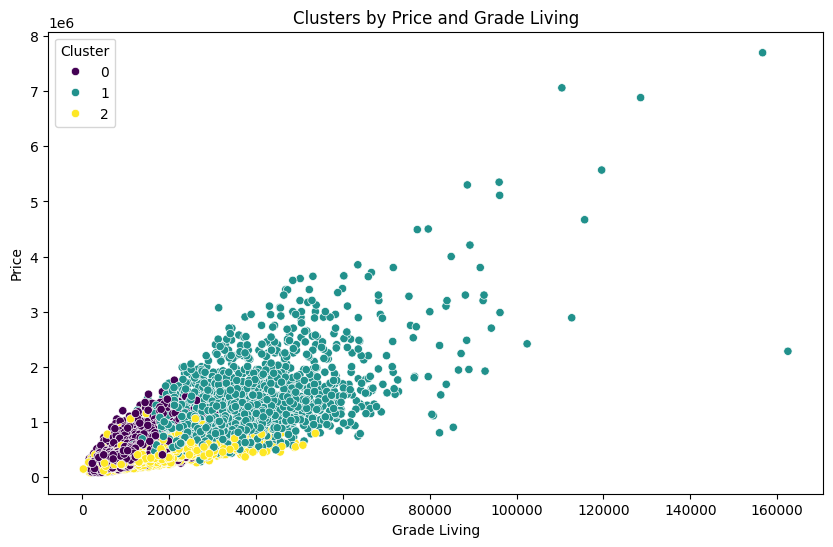

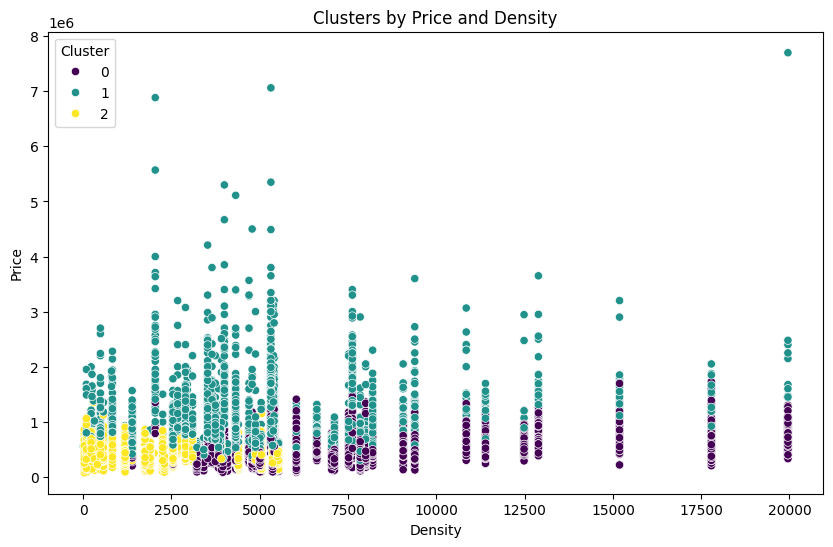

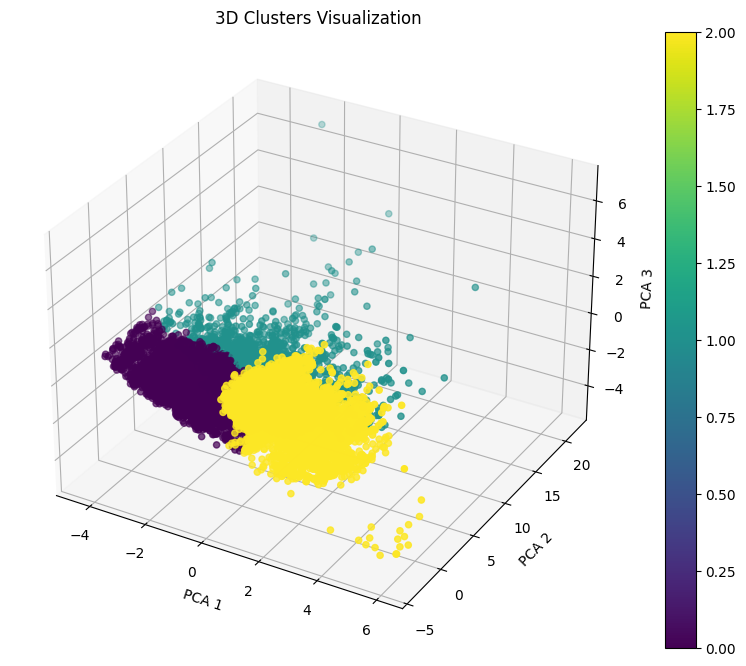

In [ ]:
# Selecting important features
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardize the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# PCA for dimensionality reduction (optional)
pca = PCA(n_components=3)
data_features_pca = pca.fit_transform(data_features_scaled)

# K-means clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette analysis
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# 2D Scatter plot for various features
def plot_scatter(x, y, xlabel, ylabel, title):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=x, y=y, hue=data['Cluster'], palette='viridis')
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

plot_scatter(data['bathrooms'], data['price'], 'Bathrooms', 'Price', 'Clusters by Price and Bathrooms')
plot_scatter(data['grade_living'], data['price'], 'Grade Living', 'Price', 'Clusters by Price and Grade Living')
plot_scatter(data['density'], data['price'], 'Density', 'Price', 'Clusters by Price and Density')

# 3D Scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(data_features_pca[:, 0], data_features_pca[:, 1], data_features_pca[:, 2],
                     c=data['Cluster'], cmap='viridis')
ax.set_title('3D Clusters Visualization')
ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')
plt.colorbar(scatter)
plt.show()

In [1]:
!pip install umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 3.9 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.35881027151967987
         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
0                        6512.261787  11893.288090  7297.790516     28.538264   
1                       12452.800140  30945.549148  4271.947932     28.080243   
2                       27001.965890  15492.248581  2344.745609     33.231140   

                 price        long  bathrooms     yr_built        lat  
Cluster                                                                
0        474300.273933 -122.299543   1.746683  1954.604396  47.624989  
1        998750.673479 -122.173696   2.981204  1987.578345  47.627276  
2        375189.499189 -122.119342   2.135943  1984.183734  47.434112  


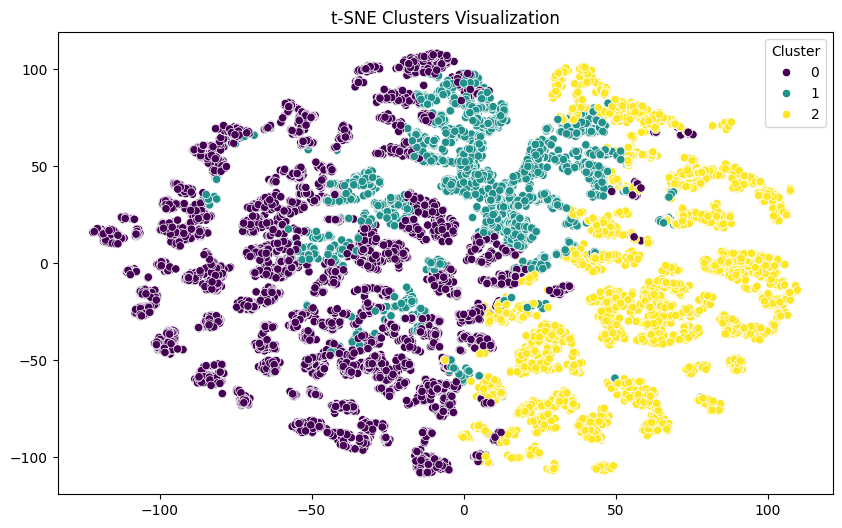

/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


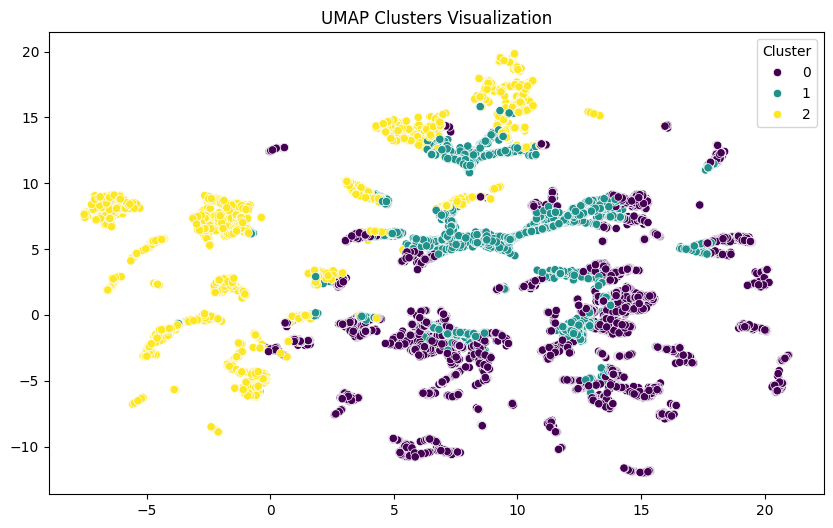

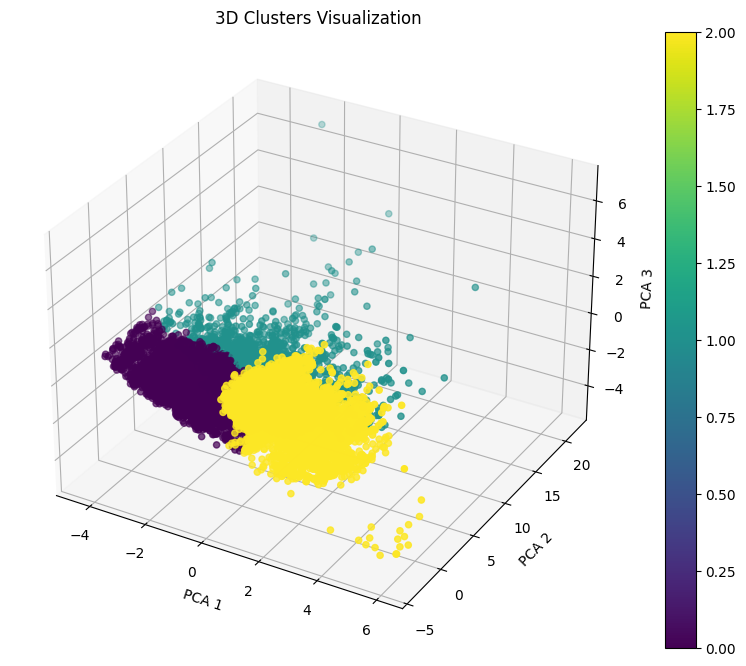

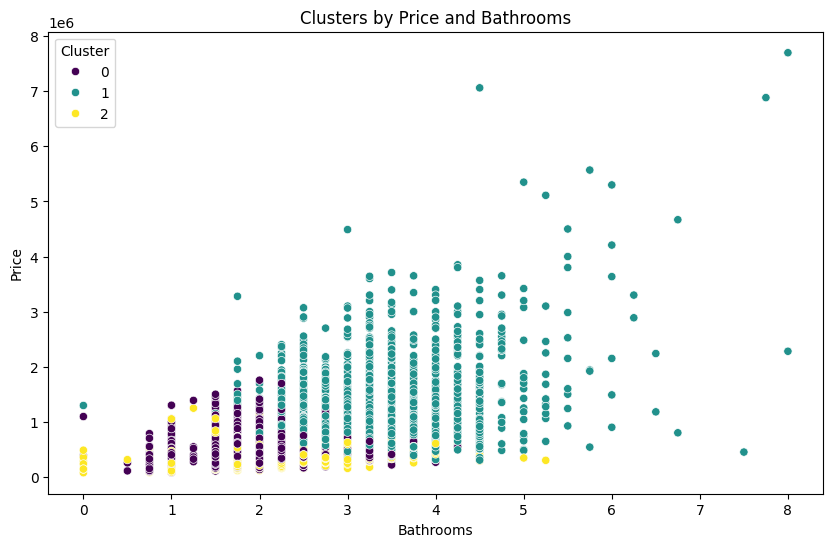

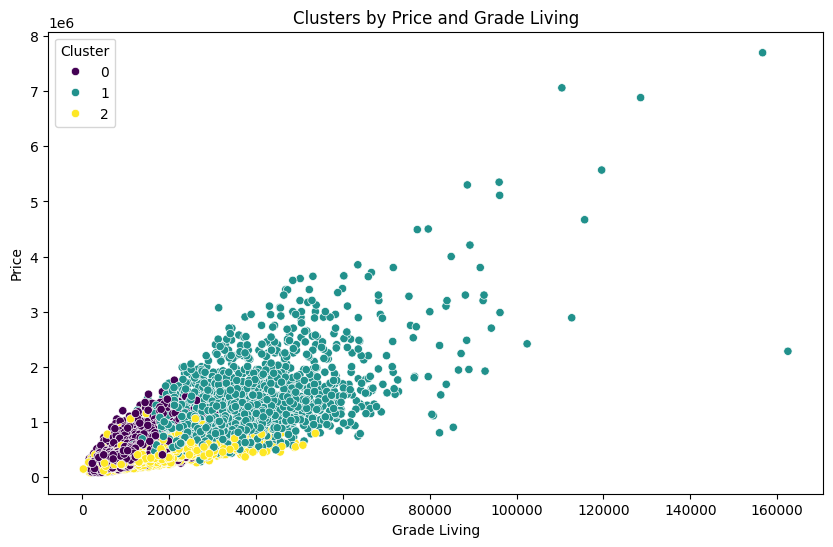

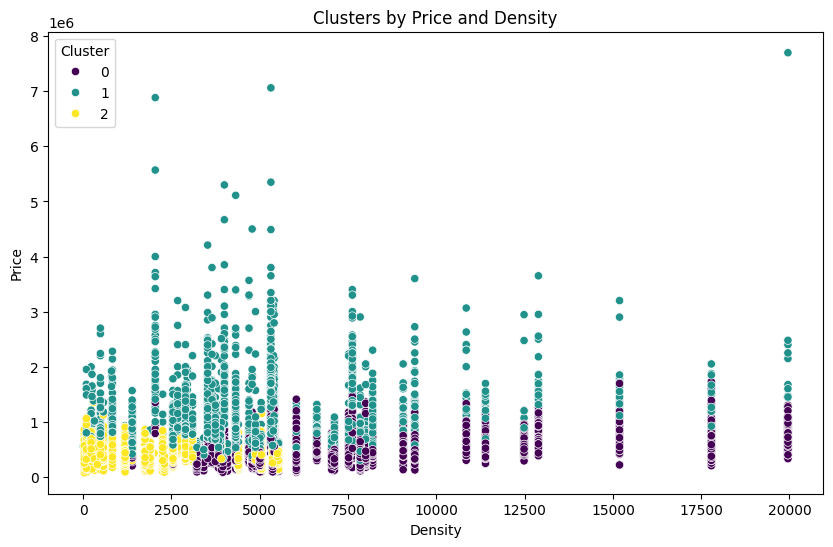

In [ ]:
from sklearn.manifold import TSNE
from umap import UMAP
# Selecting important features
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'price', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardize the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# PCA for dimensionality reduction (optional)
pca = PCA(n_components=3)
data_features_pca = pca.fit_transform(data_features_scaled)

# K-means clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette analysis
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)

# t-SNE visualization
tsne = TSNE(n_components=2, random_state=42)
data_tsne = tsne.fit_transform(data_features_scaled)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_tsne[:, 0], y=data_tsne[:, 1], hue=data['Cluster'], palette='viridis')
plt.title('t-SNE Clusters Visualization')
plt.show()

# UMAP visualization
umap = UMAP(n_components=2, random_state=42)
data_umap = umap.fit_transform(data_features_scaled)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_umap[:, 0], y=data_umap[:, 1], hue=data['Cluster'], palette='viridis')
plt.title('UMAP Clusters Visualization')
plt.show()

# 3D Scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(data_features_pca[:, 0], data_features_pca[:, 1], data_features_pca[:, 2],
                     c=data['Cluster'], cmap='viridis')
ax.set_title('3D Clusters Visualization')
ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')
plt.colorbar(scatter)
plt.show()

# 2D Scatter plot for various features
def plot_scatter(x, y, xlabel, ylabel, title):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=x, y=y, hue=data['Cluster'], palette='viridis')
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

plot_scatter(data['bathrooms'], data['price'], 'Bathrooms', 'Price', 'Clusters by Price and Bathrooms')
plot_scatter(data['grade_living'], data['price'], 'Grade Living', 'Price', 'Clusters by Price and Grade Living')
plot_scatter(data['density'], data['price'], 'Density', 'Price', 'Clusters by Price and Density')

**Classification on the Dataset**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.ensemble import RandomForestClassifier

# Select relevant features
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'long', 'bathrooms', 'yr_built', 'lat'
]

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train the Random Forest classifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred = clf.predict(X_test_scaled)

# Classification report
print(classification_report(y_test, y_pred, target_names=le.classes_))

# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Accuracy score
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy}')


              precision    recall  f1-score   support

        high       0.88      0.85      0.87      2149
         low       0.87      0.88      0.88      2168
      medium       0.76      0.77      0.76      2167

    accuracy                           0.84      6484
   macro avg       0.84      0.84      0.84      6484
weighted avg       0.84      0.84      0.84      6484

[[1834   20  295]
 [  13 1910  245]
 [ 238  255 1674]]
Accuracy: 0.8355953115360888


              precision    recall  f1-score   support

        high       0.88      0.85      0.87      2149
         low       0.87      0.88      0.88      2168
      medium       0.76      0.77      0.76      2167

    accuracy                           0.84      6484
   macro avg       0.84      0.84      0.84      6484
weighted avg       0.84      0.84      0.84      6484

[[1834   20  295]
 [  13 1910  245]
 [ 238  255 1674]]
Accuracy: 0.8355953115360888


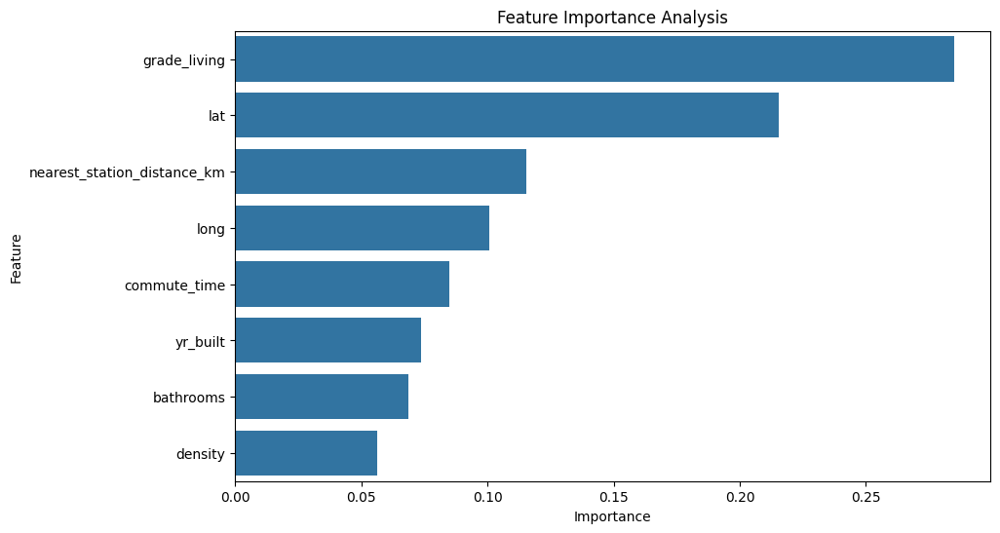

In [ ]:

# Select relevant features
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'long', 'bathrooms', 'yr_built', 'lat'
]

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train the Random Forest classifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred = clf.predict(X_test_scaled)

# Classification report
print(classification_report(y_test, y_pred, target_names=le.classes_))

# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Accuracy score
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy}')

# Feature importance analysis
importances = clf.feature_importances_
feature_names = selected_features
feature_importances = pd.DataFrame({'Feature': feature_names, 'Importance': importances})

# Sort the feature importances in descending order
feature_importances = feature_importances.sort_values('Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importances)
plt.title('Feature Importance Analysis')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()


In [ ]:
# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

**Random Forest Classifier**

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Train the Random Forest classifier
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred_rf = rf_clf.predict(X_test_scaled)

# Evaluate the model
print("Random Forest Classifier")
print(classification_report(y_test, y_pred_rf, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_rf))
print("Accuracy: ", accuracy_score(y_test, y_pred_rf))


Random Forest Classifier
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.74      0.76      0.75      2167

    accuracy                           0.82      6484
   macro avg       0.83      0.82      0.83      6484
weighted avg       0.83      0.82      0.83      6484

Confusion Matrix:
 [[1828   19  302]
 [  13 1881  274]
 [ 261  268 1638]]
Accuracy:  0.8246452806909316


**Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression

# Train the Logistic Regression classifier
lr_clf = LogisticRegression(random_state=42)
lr_clf.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred_lr = lr_clf.predict(X_test_scaled)

# Evaluate the model
print("Logistic Regression Classifier")
print(classification_report(y_test, y_pred_lr, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_lr))
print("Accuracy: ", accuracy_score(y_test, y_pred_lr))


Logistic Regression Classifier
              precision    recall  f1-score   support

        high       0.80      0.74      0.77      2149
         low       0.80      0.78      0.79      2168
      medium       0.59      0.66      0.62      2167

    accuracy                           0.72      6484
   macro avg       0.73      0.72      0.73      6484
weighted avg       0.73      0.72      0.73      6484

Confusion Matrix:
 [[1581   49  519]
 [  24 1692  452]
 [ 360  383 1424]]
Accuracy:  0.7243985194324492


**Support Vector Machine (SVM)**

In [ ]:
from sklearn.svm import SVC

# Train the SVM classifier
svm_clf = SVC(random_state=42)
svm_clf.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred_svm = svm_clf.predict(X_test_scaled)

# Evaluate the model
print("Support Vector Machine Classifier")
print(classification_report(y_test, y_pred_svm, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_svm))
print("Accuracy: ", accuracy_score(y_test, y_pred_svm))


Support Vector Machine Classifier
              precision    recall  f1-score   support

        high       0.88      0.81      0.84      2149
         low       0.87      0.84      0.85      2168
      medium       0.70      0.77      0.73      2167

    accuracy                           0.81      6484
   macro avg       0.81      0.81      0.81      6484
weighted avg       0.81      0.81      0.81      6484

Confusion Matrix:
 [[1744   22  383]
 [  11 1817  340]
 [ 236  255 1676]]
Accuracy:  0.8076804441702653


In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Random Forest Classifier
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train_scaled, y_train)
y_pred_rf = rf_clf.predict(X_test_scaled)
print("Random Forest Classifier")
print(classification_report(y_test, y_pred_rf, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_rf))
print("Accuracy: ", accuracy_score(y_test, y_pred_rf))

# Logistic Regression Classifier
lr_clf = LogisticRegression(random_state=42)
lr_clf.fit(X_train_scaled, y_train)
y_pred_lr = lr_clf.predict(X_test_scaled)
print("Logistic Regression Classifier")
print(classification_report(y_test, y_pred_lr, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_lr))
print("Accuracy: ", accuracy_score(y_test, y_pred_lr))

# Support Vector Machine Classifier
svm_clf = SVC(random_state=42)
svm_clf.fit(X_train_scaled, y_train)
y_pred_svm = svm_clf.predict(X_test_scaled)
print("Support Vector Machine Classifier")
print(classification_report(y_test, y_pred_svm, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_svm))
print("Accuracy: ", accuracy_score(y_test, y_pred_svm))

# K-Nearest Neighbors Classifier
knn_clf = KNeighborsClassifier(n_neighbors=5)
knn_clf.fit(X_train_scaled, y_train)
y_pred_knn = knn_clf.predict(X_test_scaled)
print("K-Nearest Neighbors Classifier")
print(classification_report(y_test, y_pred_knn, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_knn))
print("Accuracy: ", accuracy_score(y_test, y_pred_knn))


Random Forest Classifier
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.74      0.76      0.75      2167

    accuracy                           0.82      6484
   macro avg       0.83      0.82      0.83      6484
weighted avg       0.83      0.82      0.83      6484

Confusion Matrix:
 [[1828   19  302]
 [  13 1881  274]
 [ 261  268 1638]]
Accuracy:  0.8246452806909316
Logistic Regression Classifier
              precision    recall  f1-score   support

        high       0.80      0.74      0.77      2149
         low       0.80      0.78      0.79      2168
      medium       0.59      0.66      0.62      2167

    accuracy                           0.72      6484
   macro avg       0.73      0.72      0.73      6484
weighted avg       0.73      0.72      0.73      6484

Confusion Matrix:
 [[1581   49  519]
 [  24 1692  452]
 [ 360  383 1424]]
Accu

**Hyperparameter Tuning with Grid Search**

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier

# Define the parameter grid
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]
}

# Initialize the KNN classifier
knn_clf = KNeighborsClassifier()

# Initialize the Grid Search with Cross-Validation
grid_search = GridSearchCV(estimator=knn_clf, param_grid=param_grid, cv=5, scoring='accuracy')

# Fit the Grid Search to the training data
grid_search.fit(X_train_scaled, y_train)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

print(f'Best Parameters: {best_params}')
print(f'Best Cross-Validation Accuracy: {best_score}')


Best Parameters: {'n_neighbors': 11, 'p': 1, 'weights': 'distance'}
Best Cross-Validation Accuracy: 0.8118841336516034


In [ ]:
# Train the K-Nearest Neighbors classifier with best parameters
best_knn_clf = KNeighborsClassifier(**best_params)
best_knn_clf.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred_best_knn = best_knn_clf.predict(X_test_scaled)

# Evaluate the model
print("Optimized K-Nearest Neighbors Classifier")
print(classification_report(y_test, y_pred_best_knn, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_best_knn))
print("Accuracy: ", accuracy_score(y_test, y_pred_best_knn))


Optimized K-Nearest Neighbors Classifier
              precision    recall  f1-score   support

        high       0.88      0.84      0.86      2149
         low       0.86      0.88      0.87      2168
      medium       0.75      0.76      0.75      2167

    accuracy                           0.83      6484
   macro avg       0.83      0.83      0.83      6484
weighted avg       0.83      0.83      0.83      6484

Confusion Matrix:
 [[1815   24  310]
 [  10 1907  251]
 [ 236  281 1650]]
Accuracy:  0.8285009253547193


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
import matplotlib.pyplot as plt
import seaborn as sns


# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Random Forest Classifier
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train_scaled, y_train)
y_pred_rf = rf_clf.predict(X_test_scaled)
print("Random Forest Classifier")
print(classification_report(y_test, y_pred_rf, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_rf))
print("Accuracy: ", accuracy_score(y_test, y_pred_rf))

# Logistic Regression Classifier
lr_clf = LogisticRegression(random_state=42)
lr_clf.fit(X_train_scaled, y_train)
y_pred_lr = lr_clf.predict(X_test_scaled)
print("Logistic Regression Classifier")
print(classification_report(y_test, y_pred_lr, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_lr))
print("Accuracy: ", accuracy_score(y_test, y_pred_lr))

# Support Vector Machine Classifier
svm_clf = SVC(random_state=42)
svm_clf.fit(X_train_scaled, y_train)
y_pred_svm = svm_clf.predict(X_test_scaled)
print("Support Vector Machine Classifier")
print(classification_report(y_test, y_pred_svm, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_svm))
print("Accuracy: ", accuracy_score(y_test, y_pred_svm))

# K-Nearest Neighbors Classifier with Cross-Validation
knn_clf = KNeighborsClassifier(n_neighbors=5)
cv_scores = cross_val_score(knn_clf, X_train_scaled, y_train, cv=5, scoring='accuracy')
print(f'Cross-Validation Scores: {cv_scores}')
print(f'Mean Cross-Validation Accuracy: {cv_scores.mean()}')

# Hyperparameter Tuning with Grid Search
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]
}
grid_search = GridSearchCV(estimator=knn_clf, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)
best_params = grid_search.best_params_
best_score = grid_search.best_score_
print(f'Best Parameters: {best_params}')
print(f'Best Cross-Validation Accuracy: {best_score}')

# Train the K-Nearest Neighbors classifier with best parameters
best_knn_clf = KNeighborsClassifier(**best_params)
best_knn_clf.fit(X_train_scaled, y_train)
y_pred_best_knn = best_knn_clf.predict(X_test_scaled)
print("Optimized K-Nearest Neighbors Classifier")
print(classification_report(y_test, y_pred_best_knn, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_best_knn))
print("Accuracy: ", accuracy_score(y_test, y_pred_best_knn))



Random Forest Classifier
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.74      0.76      0.75      2167

    accuracy                           0.82      6484
   macro avg       0.83      0.82      0.83      6484
weighted avg       0.83      0.82      0.83      6484

Confusion Matrix:
 [[1828   19  302]
 [  13 1881  274]
 [ 261  268 1638]]
Accuracy:  0.8246452806909316
Logistic Regression Classifier
              precision    recall  f1-score   support

        high       0.80      0.74      0.77      2149
         low       0.80      0.78      0.79      2168
      medium       0.59      0.66      0.62      2167

    accuracy                           0.72      6484
   macro avg       0.73      0.72      0.73      6484
weighted avg       0.73      0.72      0.73      6484

Confusion Matrix:
 [[1581   49  519]
 [  24 1692  452]
 [ 360  383 1424]]
Accu

**Comparing**

In [ ]:

from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Function to evaluate classifiers using cross-validation
def evaluate_classifier(clf, X_train, y_train, X_test, y_test, classifier_name):
    cv_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='accuracy')
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    print(f"{classifier_name} Classifier")
    print(f"Cross-Validation Scores: {cv_scores}")
    print(f"Mean Cross-Validation Accuracy: {cv_scores.mean()}")
    print(f"Test Accuracy: {accuracy}")
    print(classification_report(y_test, y_pred, target_names=le.classes_))
    print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
    print("-" * 50)

# Evaluate Random Forest Classifier
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
evaluate_classifier(rf_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Random Forest")

# Evaluate Logistic Regression Classifier
lr_clf = LogisticRegression(random_state=42)
evaluate_classifier(lr_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Logistic Regression")

# Evaluate Support Vector Machine Classifier
svm_clf = SVC(random_state=42)
evaluate_classifier(svm_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Support Vector Machine")

# Perform Grid Search for K-Nearest Neighbors
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]
}
knn_clf = KNeighborsClassifier()
grid_search = GridSearchCV(estimator=knn_clf, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)
best_params = grid_search.best_params_
print(f'Best Parameters for KNN: {best_params}')

# Evaluate K-Nearest Neighbors Classifier with best parameters
best_knn_clf = KNeighborsClassifier(**best_params)
evaluate_classifier(best_knn_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Optimized K-Nearest Neighbors")


Random Forest Classifier
Cross-Validation Scores: [0.80700595 0.80469266 0.82782551 0.8172505  0.8122314 ]
Mean Cross-Validation Accuracy: 0.8138012049838043
Test Accuracy: 0.8246452806909316
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.74      0.76      0.75      2167

    accuracy                           0.82      6484
   macro avg       0.83      0.82      0.83      6484
weighted avg       0.83      0.82      0.83      6484

Confusion Matrix:
 [[1828   19  302]
 [  13 1881  274]
 [ 261  268 1638]]
--------------------------------------------------
Logistic Regression Classifier
Cross-Validation Scores: [0.70423001 0.71976206 0.73000661 0.71315268 0.7107438 ]
Mean Cross-Validation Accuracy: 0.7155790313153768
Test Accuracy: 0.7243985194324492
              precision    recall  f1-score   support

        high       0.80      0.74      0.77      

**Model Ensembling**

In [ ]:
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Function to evaluate classifiers using cross-validation
def evaluate_classifier(clf, X_train, y_train, X_test, y_test, classifier_name):
    cv_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='accuracy')
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    print(f"{classifier_name} Classifier")
    print(f"Cross-Validation Scores: {cv_scores}")
    print(f"Mean Cross-Validation Accuracy: {cv_scores.mean()}")
    print(f"Test Accuracy: {accuracy}")
    print(classification_report(y_test, y_pred, target_names=le.classes_))
    print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
    print("-" * 50)

# Evaluate Random Forest Classifier
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
evaluate_classifier(rf_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Random Forest")

# Evaluate Logistic Regression Classifier
lr_clf = LogisticRegression(random_state=42)
evaluate_classifier(lr_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Logistic Regression")

# Evaluate Support Vector Machine Classifier
svm_clf = SVC(random_state=42)
evaluate_classifier(svm_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Support Vector Machine")

# Perform Grid Search for K-Nearest Neighbors
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]
}
knn_clf = KNeighborsClassifier()
grid_search = GridSearchCV(estimator=knn_clf, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)
best_params = grid_search.best_params_
print(f'Best Parameters for KNN: {best_params}')

# Evaluate K-Nearest Neighbors Classifier with best parameters
best_knn_clf = KNeighborsClassifier(**best_params)
evaluate_classifier(best_knn_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Optimized K-Nearest Neighbors")

# Create a Voting Classifier
voting_clf = VotingClassifier(estimators=[
    ('rf', rf_clf),
    ('lr', lr_clf),
    ('svm', svm_clf),
    ('knn', best_knn_clf)
], voting='hard')

# Evaluate the Voting Classifier
evaluate_classifier(voting_clf, X_train_scaled, y_train, X_test_scaled, y_test, "Voting Classifier")


Random Forest Classifier
Cross-Validation Scores: [0.80700595 0.80469266 0.82782551 0.8172505  0.8122314 ]
Mean Cross-Validation Accuracy: 0.8138012049838043
Test Accuracy: 0.8246452806909316
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.74      0.76      0.75      2167

    accuracy                           0.82      6484
   macro avg       0.83      0.82      0.83      6484
weighted avg       0.83      0.82      0.83      6484

Confusion Matrix:
 [[1828   19  302]
 [  13 1881  274]
 [ 261  268 1638]]
--------------------------------------------------
Logistic Regression Classifier
Cross-Validation Scores: [0.70423001 0.71976206 0.73000661 0.71315268 0.7107438 ]
Mean Cross-Validation Accuracy: 0.7155790313153768
Test Accuracy: 0.7243985194324492
              precision    recall  f1-score   support

        high       0.80      0.74      0.77      

**Plot ROC Curves**

Best Parameters for KNN: {'n_neighbors': 11, 'p': 1, 'weights': 'distance'}
Random Forest Classifier
Cross-Validation Scores: [0.80931923 0.82352941 0.81658956 0.81923331 0.80429752]
Mean Cross-Validation Accuracy: 0.8145938068420794
Test Accuracy: 0.8246452806909316
ROC AUC Score: 0.9462976168850347
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.74      0.76      0.75      2167

    accuracy                           0.82      6484
   macro avg       0.83      0.82      0.83      6484
weighted avg       0.83      0.82      0.83      6484

Confusion Matrix:
 [[1828   19  302]
 [  13 1881  274]
 [ 261  268 1638]]
--------------------------------------------------
Logistic Regression Classifier
Cross-Validation Scores: [0.71050892 0.7161269  0.71810972 0.71678784 0.71338843]
Mean Cross-Validation Accuracy: 0.7149843614295937
Test Accuracy: 0.72439851943

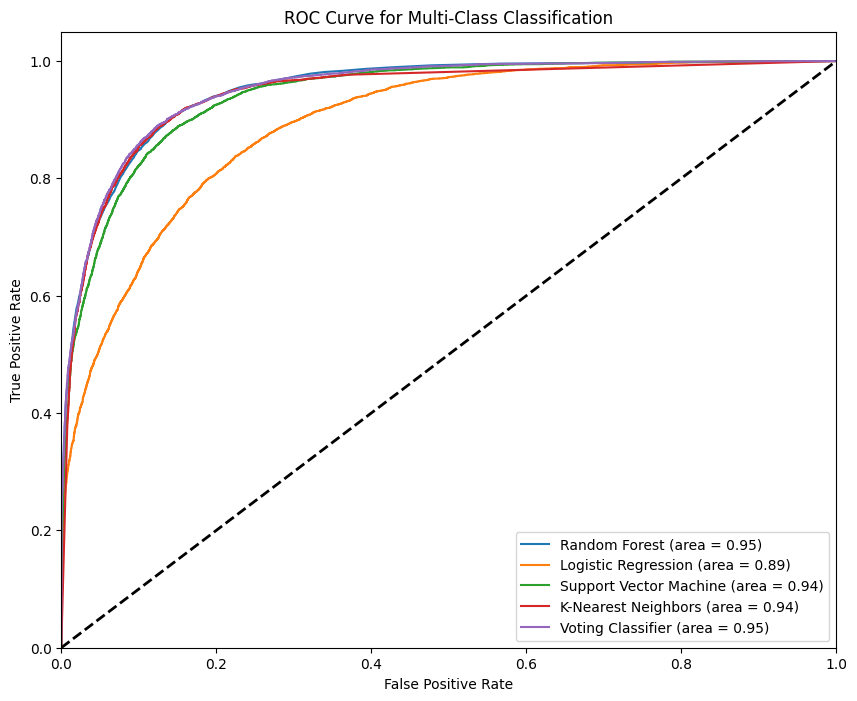

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, auc
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt
import seaborn as sns


# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])
y_bin = label_binarize(y, classes=[0, 1, 2])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)
y_bin_train, y_bin_test = train_test_split(y_bin, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Function to evaluate classifiers using cross-validation
def evaluate_classifier(clf, X_train, y_train, X_test, y_test, y_bin_test, classifier_name):
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    cv_scores = cross_val_score(clf, X_train, y_train, cv=skf, scoring='accuracy')
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_bin_test, clf.predict_proba(X_test), multi_class='ovr')

    print(f"{classifier_name} Classifier")
    print(f"Cross-Validation Scores: {cv_scores}")
    print(f"Mean Cross-Validation Accuracy: {cv_scores.mean()}")
    print(f"Test Accuracy: {accuracy}")
    print(f"ROC AUC Score: {roc_auc}")
    print(classification_report(y_test, y_pred, target_names=le.classes_))
    print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
    print("-" * 50)
    return clf

# Initialize classifiers
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
lr_clf = LogisticRegression(random_state=42, max_iter=1000)
svm_clf = SVC(probability=True, random_state=42)
knn_clf = KNeighborsClassifier()

# Perform Grid Search for K-Nearest Neighbors
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]
}
grid_search = GridSearchCV(estimator=knn_clf, param_grid=param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)
best_params = grid_search.best_params_
print(f'Best Parameters for KNN: {best_params}')
best_knn_clf = KNeighborsClassifier(**best_params)

# Train and evaluate classifiers
rf_clf = evaluate_classifier(rf_clf, X_train_scaled, y_train, X_test_scaled, y_test, y_bin_test, "Random Forest")
lr_clf = evaluate_classifier(lr_clf, X_train_scaled, y_train, X_test_scaled, y_test, y_bin_test, "Logistic Regression")
svm_clf = evaluate_classifier(svm_clf, X_train_scaled, y_train, X_test_scaled, y_test, y_bin_test, "Support Vector Machine")
best_knn_clf = evaluate_classifier(best_knn_clf, X_train_scaled, y_train, X_test_scaled, y_test, y_bin_test, "Optimized K-Nearest Neighbors")

# Create a Voting Classifier
voting_clf = VotingClassifier(estimators=[
    ('rf', RandomForestClassifier(n_estimators=100, random_state=42)),
    ('lr', LogisticRegression(random_state=42, max_iter=1000)),
    ('svm', SVC(probability=True, random_state=42)),
    ('knn', KNeighborsClassifier(**best_params))
], voting='soft')

voting_clf = evaluate_classifier(voting_clf, X_train_scaled, y_train, X_test_scaled, y_test, y_bin_test, "Voting Classifier")

# Function to plot ROC curve for each classifier
def plot_roc_curve(classifiers, X_test, y_test, y_bin_test, le):
    plt.figure(figsize=(10, 8))

    for name, clf in classifiers.items():
        if hasattr(clf, "predict_proba"):
            y_prob = clf.predict_proba(X_test)
        elif hasattr(clf, "decision_function"):
            y_prob = clf.decision_function(X_test)
            y_prob = np.exp(y_prob) / np.sum(np.exp(y_prob), axis=1, keepdims=True)  # softmax
        else:
            raise ValueError(f"Classifier {name} does not have a predict_proba or decision_function method.")

        fpr = {}
        tpr = {}
        roc_auc = {}

        for i in range(len(le.classes_)):
            fpr[i], tpr[i], _ = roc_curve(y_bin_test[:, i], y_prob[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])

        # Compute micro-average ROC curve and ROC area
        fpr["micro"], tpr["micro"], _ = roc_curve(y_bin_test.ravel(), y_prob.ravel())
        roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

        plt.plot(fpr["micro"], tpr["micro"], label=f'{name} (area = {roc_auc["micro"]:.2f})')

    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve for Multi-Class Classification')
    plt.legend(loc="lower right")
    plt.show()

# List of classifiers to plot ROC curve
classifiers = {
    "Random Forest": rf_clf,
    "Logistic Regression": lr_clf,
    "Support Vector Machine": svm_clf,
    "K-Nearest Neighbors": best_knn_clf,
    "Voting Classifier": voting_clf
}

# Plot ROC curves for all classifiers
plot_roc_curve(classifiers, X_test_scaled, y_test, y_bin_test, le)


**Summary**




**Voting Classifier and Random Forest:**  These classifiers have the highest AUC scores, suggesting they are the best performing models for this multi-class classification task.

**Logistic Regression**: While still effective, this model has a slightly lower AUC compared to the others, indicating it may not be capturing the complexity of the data as well as the other models.

**Support Vector Machine and K-Nearest Neighbors:** Both classifiers perform well, with AUC scores of 0.94, indicating they are strong candidates for this classification problem.

Random Forest Classifier
Cross-Validation Scores: [0.80931923 0.82352941 0.81658956 0.81923331 0.80429752]
Mean Cross-Validation Accuracy: 0.8145938068420794
Test Accuracy: 0.8246452806909316
ROC AUC Score: 0.9462976168850347
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.74      0.76      0.75      2167

    accuracy                           0.82      6484
   macro avg       0.83      0.82      0.83      6484
weighted avg       0.83      0.82      0.83      6484

Confusion Matrix:
 [[1828   19  302]
 [  13 1881  274]
 [ 261  268 1638]]
--------------------------------------------------


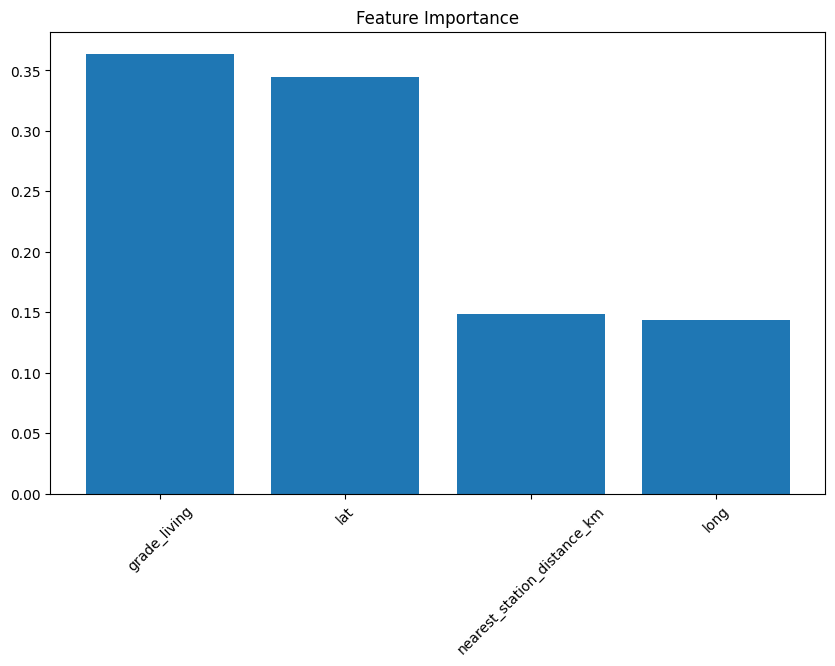

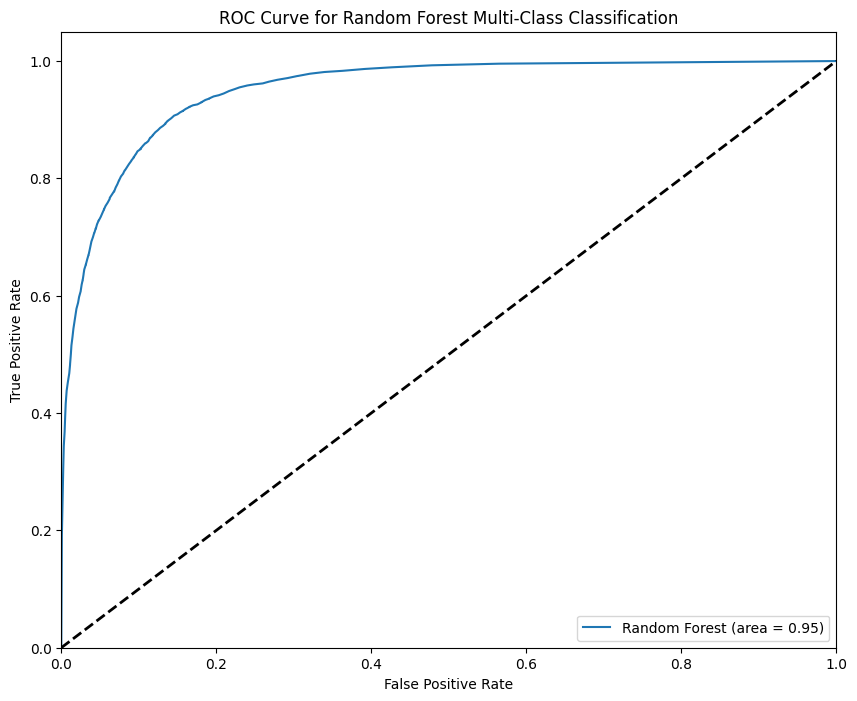

In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, auc
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns


# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])
y_bin = label_binarize(y, classes=[0, 1, 2])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)
y_bin_train, y_bin_test = train_test_split(y_bin, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train the Random Forest Classifier
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train_scaled, y_train)

# Evaluate the classifier
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = cross_val_score(rf_clf, X_train_scaled, y_train, cv=skf, scoring='accuracy')
y_pred = rf_clf.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_bin_test, rf_clf.predict_proba(X_test_scaled), multi_class='ovr')

print(f"Random Forest Classifier")
print(f"Cross-Validation Scores: {cv_scores}")
print(f"Mean Cross-Validation Accuracy: {cv_scores.mean()}")
print(f"Test Accuracy: {accuracy}")
print(f"ROC AUC Score: {roc_auc}")
print(classification_report(y_test, y_pred, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("-" * 50)

# Feature Importance
feature_importances = rf_clf.feature_importances_
features = selected_features
indices = np.argsort(feature_importances)[::-1]

plt.figure(figsize=(10, 6))
plt.title("Feature Importance")
plt.bar(range(len(feature_importances)), feature_importances[indices], align="center")
plt.xticks(range(len(feature_importances)), [features[i] for i in indices], rotation=45)
plt.show()

# ROC Curve for Random Forest
fpr = {}
tpr = {}
roc_auc = {}

for i in range(len(le.classes_)):
    fpr[i], tpr[i], _ = roc_curve(y_bin_test[:, i], rf_clf.predict_proba(X_test_scaled)[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_bin_test.ravel(), rf_clf.predict_proba(X_test_scaled).ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure(figsize=(10, 8))
plt.plot(fpr["micro"], tpr["micro"], label=f'Random Forest (area = {roc_auc["micro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Random Forest Multi-Class Classification')
plt.legend(loc="lower right")
plt.show()


**XGBOST**

XGBoost Classifier
Cross-Validation Scores: [0.81791143 0.82088566 0.81758096 0.82485129 0.82247934]
Mean Cross-Validation Accuracy: 0.8207417369027656
Test Accuracy: 0.8289636027143739
ROC AUC Score: 0.9476826559846359
              precision    recall  f1-score   support

        high       0.87      0.85      0.86      2149
         low       0.87      0.87      0.87      2168
      medium       0.75      0.76      0.75      2167

    accuracy                           0.83      6484
   macro avg       0.83      0.83      0.83      6484
weighted avg       0.83      0.83      0.83      6484

Confusion Matrix:
 [[1832   20  297]
 [  11 1893  264]
 [ 253  264 1650]]
--------------------------------------------------


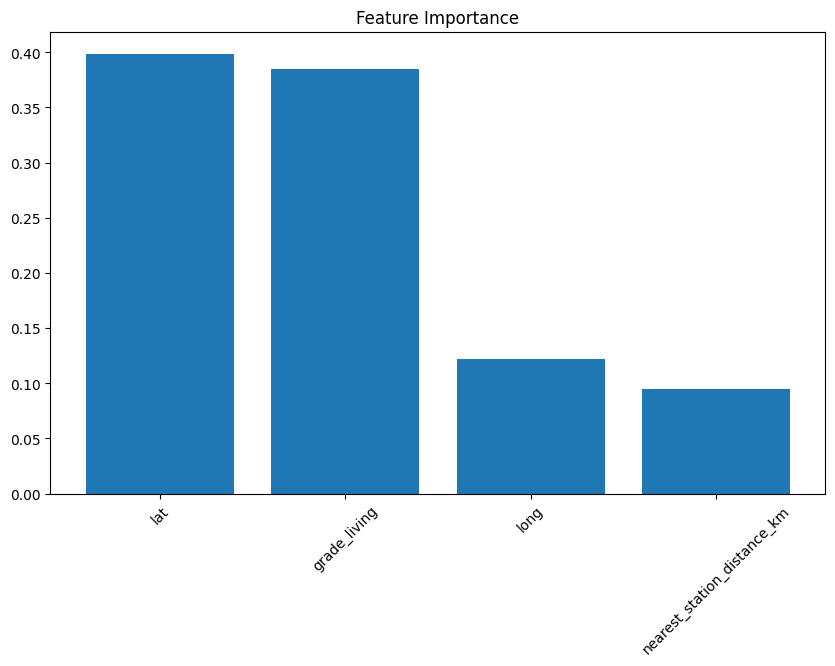

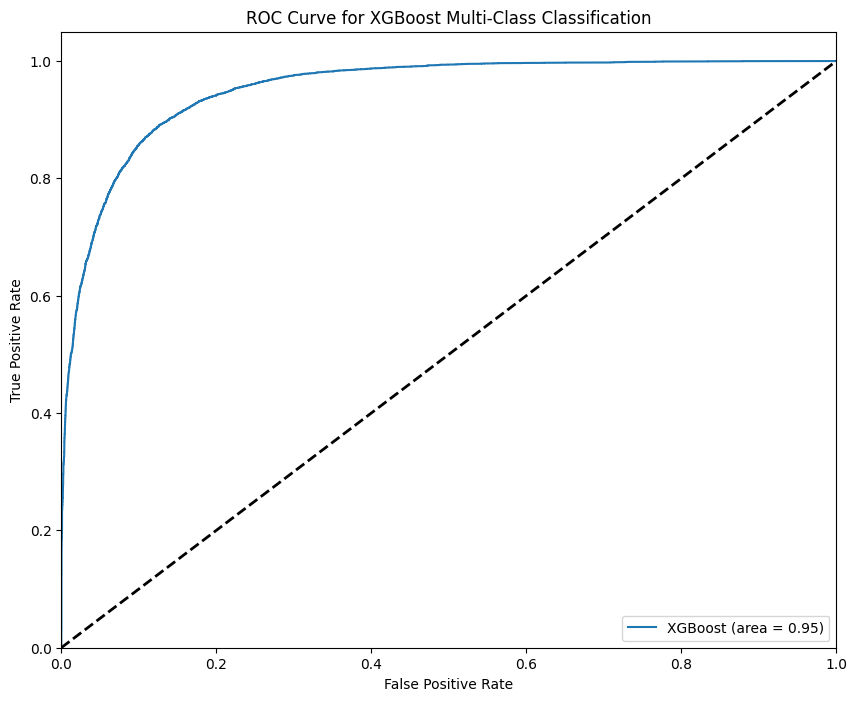

In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, auc
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns


# Select top important features
selected_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

X = data[selected_features]

# Define the target variable (price categories)
data['price_category'] = pd.qcut(data['price'], q=3, labels=['low', 'medium', 'high'])

# Encode the target variable
le = LabelEncoder()
y = le.fit_transform(data['price_category'])
y_bin = label_binarize(y, classes=[0, 1, 2])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)
y_bin_train, y_bin_test = train_test_split(y_bin, test_size=0.3, random_state=42, stratify=y)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train the XGBoost Classifier
xgb_clf = xgb.XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42)
xgb_clf.fit(X_train_scaled, y_train)

# Evaluate the classifier
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = cross_val_score(xgb_clf, X_train_scaled, y_train, cv=skf, scoring='accuracy')
y_pred = xgb_clf.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_bin_test, xgb_clf.predict_proba(X_test_scaled), multi_class='ovr')

print(f"XGBoost Classifier")
print(f"Cross-Validation Scores: {cv_scores}")
print(f"Mean Cross-Validation Accuracy: {cv_scores.mean()}")
print(f"Test Accuracy: {accuracy}")
print(f"ROC AUC Score: {roc_auc}")
print(classification_report(y_test, y_pred, target_names=le.classes_))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("-" * 50)

# Feature Importance
feature_importances = xgb_clf.feature_importances_
features = selected_features
indices = np.argsort(feature_importances)[::-1]

plt.figure(figsize=(10, 6))
plt.title("Feature Importance")
plt.bar(range(len(feature_importances)), feature_importances[indices], align="center")
plt.xticks(range(len(feature_importances)), [features[i] for i in indices], rotation=45)
plt.show()

# ROC Curve for XGBoost
fpr = {}
tpr = {}
roc_auc = {}

for i in range(len(le.classes_)):
    fpr[i], tpr[i], _ = roc_curve(y_bin_test[:, i], xgb_clf.predict_proba(X_test_scaled)[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_bin_test.ravel(), xgb_clf.predict_proba(X_test_scaled).ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure(figsize=(10, 8))
plt.plot(fpr["micro"], tpr["micro"], label=f'XGBoost (area = {roc_auc["micro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for XGBoost Multi-Class Classification')
plt.legend(loc="lower right")
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


XGBoost Classifier
Cross-Validation Scores: [0.99471249 0.99206874 0.99272968 0.99372108 0.99272727]
Mean Cross-Validation Accuracy: 0.9931918524304513
Test Accuracy: 0.992442936458976
ROC AUC Score: 0.999923602798294
              precision    recall  f1-score   support

           0       1.00      0.99      0.99      3277
           1       0.99      1.00      0.99      1612
           2       0.98      0.99      0.99      1595

    accuracy                           0.99      6484
   macro avg       0.99      0.99      0.99      6484
weighted avg       0.99      0.99      0.99      6484

Confusion Matrix:
 [[3247    5   25]
 [   2 1606    4]
 [   7    6 1582]]
--------------------------------------------------


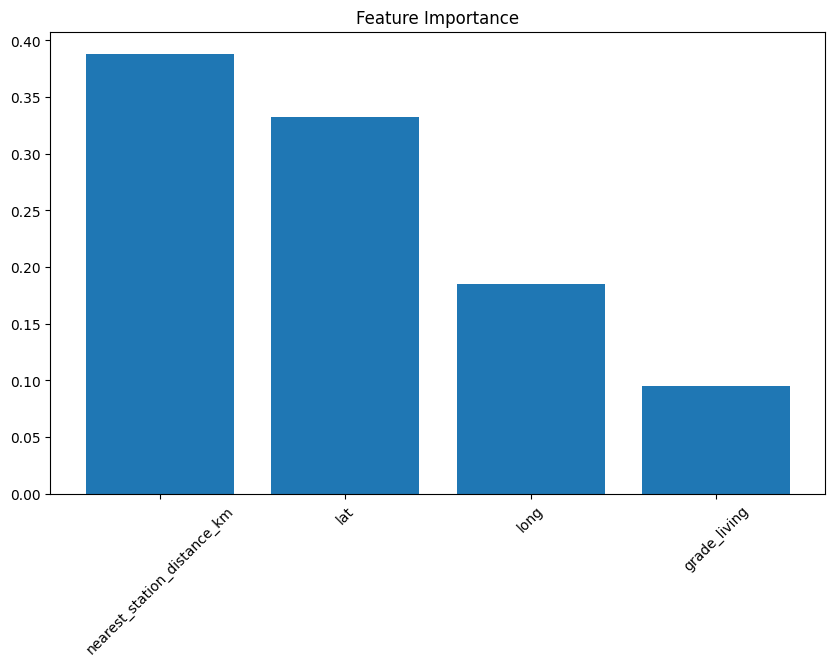

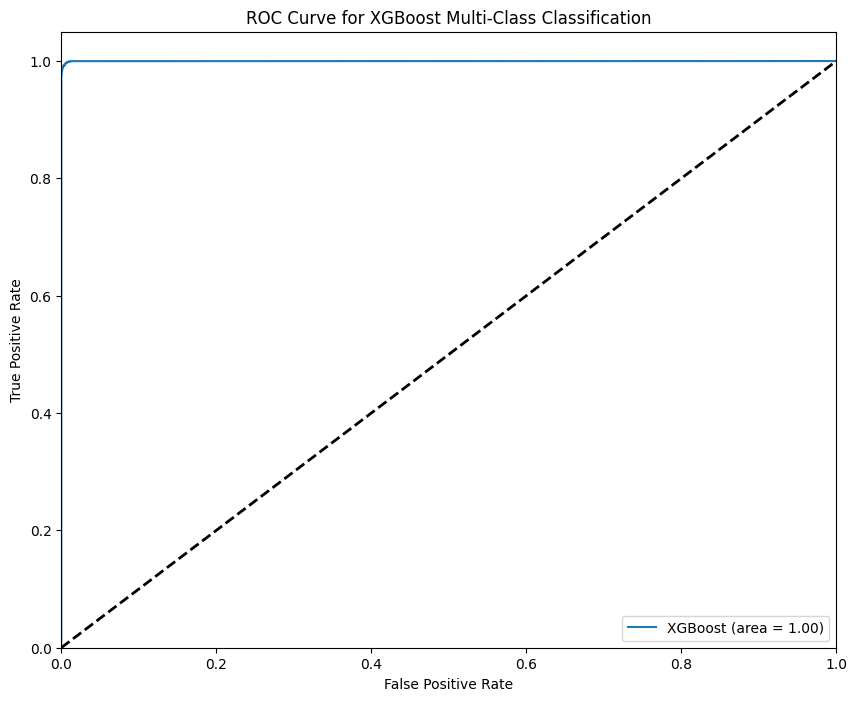

In [ ]:

from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, auc
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb


# Select top important features for clustering
clustering_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data[clustering_features])

# Step 1: Clustering
kmeans = KMeans(n_clusters=3, random_state=42)
data['cluster'] = kmeans.fit_predict(data_scaled)

# Step 2: Classification Modeling
# Define the features and target variable for classification
X = data[clustering_features]
y = data['cluster']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Train the XGBoost Classifier
xgb_clf = xgb.XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42)
xgb_clf.fit(X_train, y_train)

# Evaluate the classifier
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = cross_val_score(xgb_clf, X_train, y_train, cv=skf, scoring='accuracy')
y_pred = xgb_clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(pd.get_dummies(y_test), xgb_clf.predict_proba(X_test), multi_class='ovr')

print(f"XGBoost Classifier")
print(f"Cross-Validation Scores: {cv_scores}")
print(f"Mean Cross-Validation Accuracy: {cv_scores.mean()}")
print(f"Test Accuracy: {accuracy}")
print(f"ROC AUC Score: {roc_auc}")
print(classification_report(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("-" * 50)

# Feature Importance
feature_importances = xgb_clf.feature_importances_
features = clustering_features
indices = np.argsort(feature_importances)[::-1]

plt.figure(figsize=(10, 6))
plt.title("Feature Importance")
plt.bar(range(len(feature_importances)), feature_importances[indices], align="center")
plt.xticks(range(len(feature_importances)), [features[i] for i in indices], rotation=45)
plt.show()

# ROC Curve for XGBoost
fpr = {}
tpr = {}
roc_auc = {}

for i in range(len(np.unique(y))):
    fpr[i], tpr[i], _ = roc_curve((y_test == i).astype(int), xgb_clf.predict_proba(X_test)[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(pd.get_dummies(y_test).values.ravel(), xgb_clf.predict_proba(X_test).ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure(figsize=(10, 8))
plt.plot(fpr["micro"], tpr["micro"], label=f'XGBoost (area = {roc_auc["micro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for XGBoost Multi-Class Classification')
plt.legend(loc="lower right")
plt.show()


**Hyperparameter Tuning**

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Fitting 5 folds for each of 216 candidates, totalling 1080 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()
/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Best Parameters: {'colsample_bytree': 1.0, 'gamma': 0.2, 'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 200, 'subsample': 0.8}
XGBoost Classifier with Tuned Hyperparameters
Cross-Validation Scores: [0.99372108 0.99339061 0.99339061 0.99372108 0.99338843]
Mean Cross-Validation Accuracy: 0.993522365395225
Test Accuracy: 0.9932140653917335
ROC AUC Score: 0.9999276717949982
              precision    recall  f1-score   support

           0       1.00      0.99      0.99      3277
           1       0.99      1.00      0.99      1612
           2       0.99      0.99      0.99      1595

    accuracy                           0.99      6484
   macro avg       0.99      0.99      0.99      6484
weighted avg       0.99      0.99      0.99      6484

Confusion Matrix:
 [[3251    6   20]
 [   4 1604    4]
 [   5    5 1585]]
--------------------------------------------------


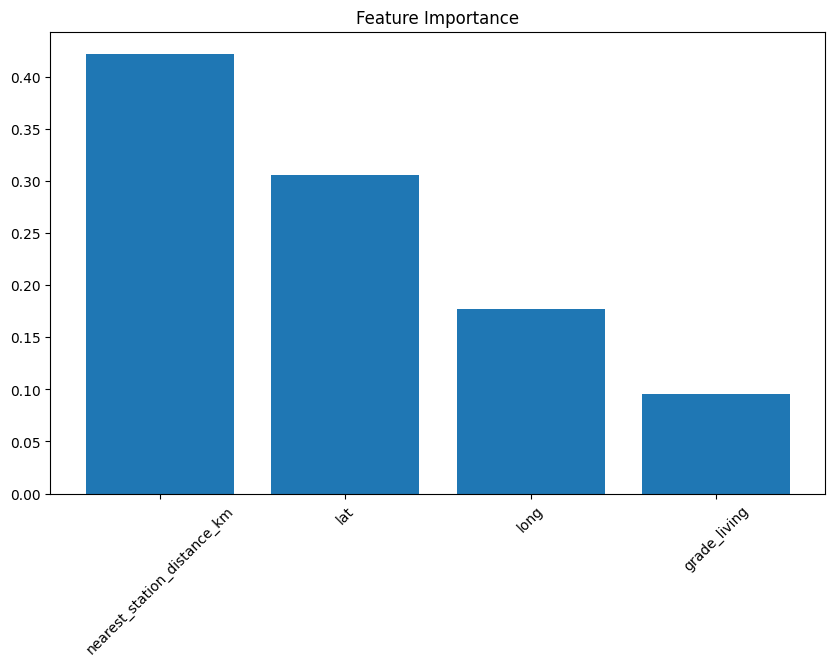

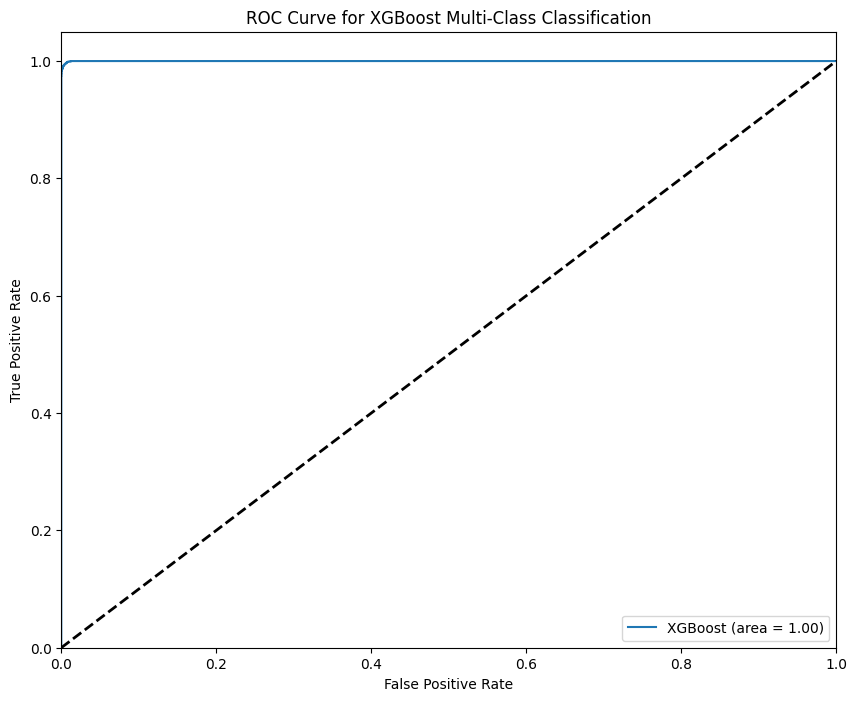

In [ ]:

from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, auc
from sklearn.cluster import KMeans
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns


# Select top important features for clustering
clustering_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data[clustering_features])

# Step 1: Clustering
kmeans = KMeans(n_clusters=3, random_state=42)
data['cluster'] = kmeans.fit_predict(data_scaled)

# Step 2: Classification Modeling
# Define the features and target variable for classification
X = data[clustering_features]
y = data['cluster']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Hyperparameter tuning for XGBoost using GridSearchCV
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'gamma': [0, 0.1, 0.2]
}

xgb_clf = xgb.XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42)

grid_search = GridSearchCV(estimator=xgb_clf, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
print(f'Best Parameters: {best_params}')

# Train the XGBoost Classifier with the best parameters
xgb_clf = xgb.XGBClassifier(**best_params, use_label_encoder=False, eval_metric='mlogloss', random_state=42)
xgb_clf.fit(X_train, y_train)

# Evaluate the classifier
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = cross_val_score(xgb_clf, X_train, y_train, cv=skf, scoring='accuracy')
y_pred = xgb_clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(pd.get_dummies(y_test), xgb_clf.predict_proba(X_test), multi_class='ovr')

print(f"XGBoost Classifier with Tuned Hyperparameters")
print(f"Cross-Validation Scores: {cv_scores}")
print(f"Mean Cross-Validation Accuracy: {cv_scores.mean()}")
print(f"Test Accuracy: {accuracy}")
print(f"ROC AUC Score: {roc_auc}")
print(classification_report(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("-" * 50)

# Feature Importance
feature_importances = xgb_clf.feature_importances_
features = clustering_features
indices = np.argsort(feature_importances)[::-1]

plt.figure(figsize=(10, 6))
plt.title("Feature Importance")
plt.bar(range(len(feature_importances)), feature_importances[indices], align="center")
plt.xticks(range(len(feature_importances)), [features[i] for i in indices], rotation=45)
plt.show()

# ROC Curve for XGBoost
fpr = {}
tpr = {}
roc_auc = {}

for i in range(len(np.unique(y))):
    fpr[i], tpr[i], _ = roc_curve((y_test == i).astype(int), xgb_clf.predict_proba(X_test)[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(pd.get_dummies(y_test).values.ravel(), xgb_clf.predict_proba(X_test).ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

plt.figure(figsize=(10, 8))
plt.plot(fpr["micro"], tpr["micro"], label=f'XGBoost (area = {roc_auc["micro"]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for XGBoost Multi-Class Classification')
plt.legend(loc="lower right")
plt.show()


**Regression Modeling**

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Cluster 0 - RMSE: 118037.8115589658
Cluster 2 - RMSE: 216975.5446150115
Cluster 1 - RMSE: 58712.92900832075
RMSE for each cluster: {0: 118037.8115589658, 2: 216975.5446150115, 1: 58712.92900832075}


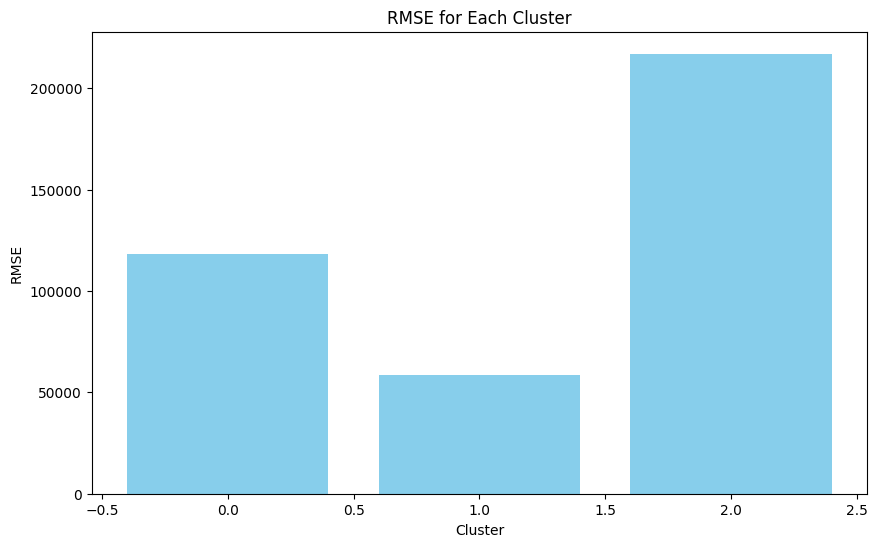

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, auc, mean_squared_error
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb


# Select top important features for clustering
clustering_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data[clustering_features])

# Step 1: Clustering
kmeans = KMeans(n_clusters=3, random_state=42)
data['cluster'] = kmeans.fit_predict(data_scaled)

# Step 2: Classification Modeling
# Define the features and target variable for classification
X = data[clustering_features]
y = data['cluster']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Train the XGBoost Classifier
xgb_clf = xgb.XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42)
xgb_clf.fit(X_train, y_train)

# Predict clusters on the entire dataset
data['predicted_cluster'] = xgb_clf.predict(X)

# Prepare for regression modeling
regression_features = clustering_features + ['bathrooms', 'bedrooms', 'sqft_lot']
data = data[regression_features + ['price', 'predicted_cluster']]

# Function to train and evaluate regression models
def train_evaluate_regression_model(data, cluster_label):
    cluster_data = data[data['predicted_cluster'] == cluster_label]
    X = cluster_data[regression_features]
    y = cluster_data['price']

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Train the regression model (using RandomForestRegressor here, but can be replaced with any regression model)
    regressor = RandomForestRegressor(n_estimators=100, random_state=42)
    regressor.fit(X_train, y_train)

    # Predict on the test set
    y_pred = regressor.predict(X_test)

    # Evaluate the model
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f"Cluster {cluster_label} - RMSE: {rmse}")

    return regressor, rmse

# Train and evaluate regression models for each cluster
regression_models = {}
rmses = {}

for cluster_label in data['predicted_cluster'].unique():
    model, rmse = train_evaluate_regression_model(data, cluster_label)
    regression_models[cluster_label] = model
    rmses[cluster_label] = rmse

print("RMSE for each cluster:", rmses)

# Plot RMSE for each cluster
plt.figure(figsize=(10, 6))
plt.bar(rmses.keys(), rmses.values(), color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('RMSE')
plt.title('RMSE for Each Cluster')
plt.show()


Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best Parameters for Cluster 0: {'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}
Cluster 0 - RMSE: 118621.10995726268
Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best Parameters for Cluster 2: {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Cluster 2 - RMSE: 216168.50048008372
Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best Parameters for Cluster 1: {'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}
Cluster 1 - RMSE: 58729.49886213794
RMSE for each cluster: {0: 118621.10995726268, 2: 216168.50048008372, 1: 58729.49886213794}


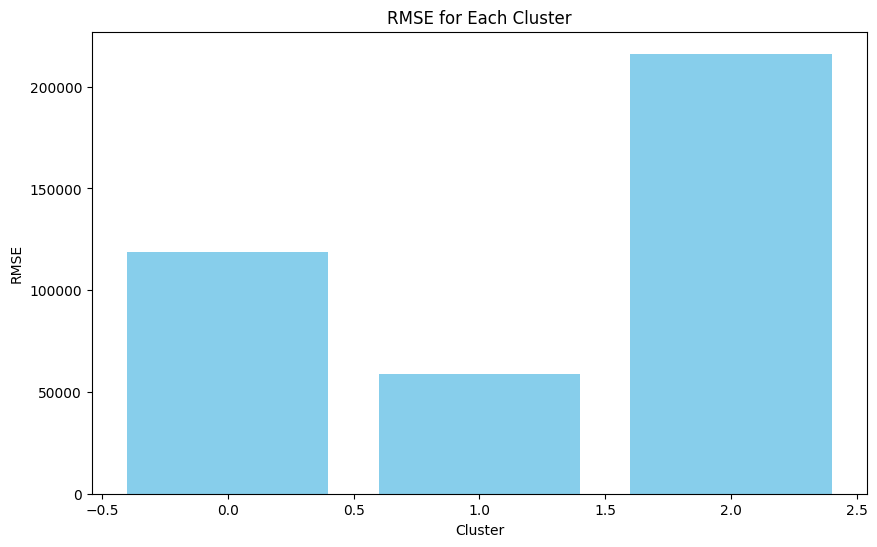

In [ ]:
from sklearn.model_selection import GridSearchCV

# Function to train and evaluate regression models with hyperparameter tuning
def train_evaluate_regression_model(data, cluster_label):
    cluster_data = data[data['predicted_cluster'] == cluster_label]
    X = cluster_data[regression_features]
    y = cluster_data['price']

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Define the parameter grid for RandomForestRegressor
    param_grid = {
        'n_estimators': [100, 200],
        'max_depth': [None, 10, 20],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2]
    }

    # Initialize the regressor
    regressor = RandomForestRegressor(random_state=42)

    # Perform GridSearchCV
    grid_search = GridSearchCV(estimator=regressor, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    print(f'Best Parameters for Cluster {cluster_label}: {best_params}')

    # Train the best model
    best_regressor = RandomForestRegressor(**best_params, random_state=42)
    best_regressor.fit(X_train, y_train)

    # Predict on the test set
    y_pred = best_regressor.predict(X_test)

    # Evaluate the model
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f"Cluster {cluster_label} - RMSE: {rmse}")

    return best_regressor, rmse

# Train and evaluate regression models for each cluster with hyperparameter tuning
regression_models = {}
rmses = {}

for cluster_label in data['predicted_cluster'].unique():
    model, rmse = train_evaluate_regression_model(data, cluster_label)
    regression_models[cluster_label] = model
    rmses[cluster_label] = rmse

print("RMSE for each cluster:", rmses)

# Plot RMSE for each cluster
plt.figure(figsize=(10, 6))
plt.bar(rmses.keys(), rmses.values(), color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('RMSE')
plt.title('RMSE for Each Cluster')
plt.show()


In [ ]:
data= df.copy()

**LAST STEP**

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'colsample_bytree': 1.0, 'gamma': 0.2, 'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 200, 'subsample': 0.8}
Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best Parameters for Cluster 0: {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}
Cluster 0 - RMSE: 123662.44682419475
Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best Parameters for Cluster 2: {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}
Cluster 2 - RMSE: 228378.46677197338
Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best Parameters for Cluster 1: {'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 100}
Cluster 1 - RMSE: 56287.193307090325
RMSE for each cluster: {0: 123662.44682419475, 2: 228378.46677197338, 1: 56287.193307090325}


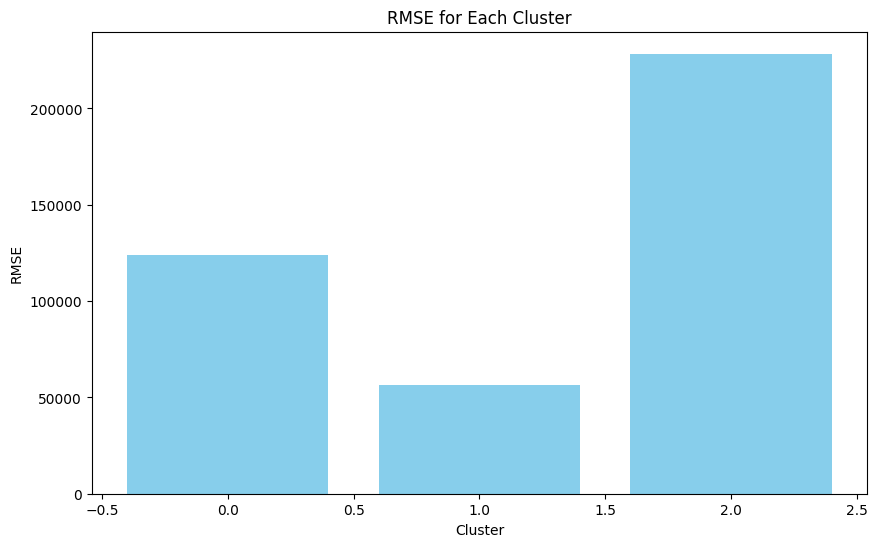

Predicted Price: [221763.08113005]
Maximum Price: [345425.52795425]
Minimum Price: [98100.63430586]
Information of the most similar house: price                                      221900.0
bedrooms                                          3
bathrooms                                       1.0
sqft_lot                                       5650
floors                                          1.0
waterfront                                        0
view                                              0
condition                                         3
yr_built                                       1955
yr_renovated                                      0
zipcode                                       98178
lat                                         47.5112
long                                       -122.257
nearest_station_distance_km             8620.002287
bathroom_category              Studio or 1 Bathroom
density                                      5364.0
commute_time                 

In [ ]:
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, auc, mean_squared_error
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns


# Select top important features for clustering and regression
clustering_features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long']
regression_features = clustering_features + ['bathrooms', 'bedrooms', 'sqft_lot']

# Standardize the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data[clustering_features])

# Step 1: Clustering
kmeans = KMeans(n_clusters=3, random_state=42)
data['cluster'] = kmeans.fit_predict(data_scaled)

# Step 2: Classification Modeling
X = data[clustering_features]
y = data['cluster']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'gamma': [0, 0.1, 0.2]
}

xgb_clf = xgb.XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42)
grid_search = GridSearchCV(estimator=xgb_clf, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
print(f'Best Parameters: {best_params}')

xgb_clf = xgb.XGBClassifier(**best_params, use_label_encoder=False, eval_metric='mlogloss', random_state=42)
xgb_clf.fit(X_train, y_train)

data['predicted_cluster'] = xgb_clf.predict(X)

# Step 3: Regression Modeling
def train_evaluate_regression_model(data, cluster_label):
    cluster_data = data[data['predicted_cluster'] == cluster_label]
    X = cluster_data[regression_features]
    y = cluster_data['price']

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    param_grid = {
        'n_estimators': [100, 200],
        'max_depth': [None, 10, 20],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2]
    }

    regressor = RandomForestRegressor(random_state=42)
    grid_search = GridSearchCV(estimator=regressor, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    print(f'Best Parameters for Cluster {cluster_label}: {best_params}')

    best_regressor = RandomForestRegressor(**best_params, random_state=42)
    best_regressor.fit(X_train, y_train)

    y_pred = best_regressor.predict(X_test)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f"Cluster {cluster_label} - RMSE: {rmse}")

    return best_regressor, rmse

regression_models = {}
rmses = {}

for cluster_label in data['predicted_cluster'].unique():
    model, rmse = train_evaluate_regression_model(data, cluster_label)
    regression_models[cluster_label] = model
    rmses[cluster_label] = rmse

print("RMSE for each cluster:", rmses)

# Plot RMSE for each cluster
plt.figure(figsize=(10, 6))
plt.bar(rmses.keys(), rmses.values(), color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('RMSE')
plt.title('RMSE for Each Cluster')
plt.show()

# Step 4: Web Application Integration

def predict_price(new_data):
    new_data_scaled = scaler.transform(new_data[clustering_features])
    predicted_cluster = xgb_clf.predict(new_data_scaled)

    cluster_label = predicted_cluster[0]
    regression_model = regression_models[cluster_label]

    predicted_price = regression_model.predict(new_data[regression_features])
    rmse = rmses[cluster_label]

    max_price = predicted_price + rmse
    min_price = predicted_price - rmse

    similar_house = data[(data['predicted_cluster'] == cluster_label) & (np.abs(data['price'] - predicted_price) < rmse)]
    similar_house_info = similar_house.iloc[0]

    return predicted_price, max_price, min_price, similar_house_info

# Example usage
new_house_data = pd.DataFrame({
    'grade_living': [1000],
    'lat': [47.5],
    'nearest_station_distance_km': [5000],
    'long': [-122.2],
    'bathrooms': [2],
    'bedrooms': [3],
    'sqft_lot': [7000]
})

predicted_price, max_price, min_price, similar_house_info = predict_price(new_house_data)
print(f"Predicted Price: {predicted_price}")
print(f"Maximum Price: {max_price}")
print(f"Minimum Price: {min_price}")
print(f"Information of the most similar house: {similar_house_info}")


Fitting 5 folds for each of 50 candidates, totalling 250 fits
Best Parameters: {'subsample': 0.7, 'n_estimators': 100, 'max_depth': 6, 'learning_rate': 0.1, 'gamma': 0.2, 'colsample_bytree': 0.8}
RMSE: 151456.92927743765


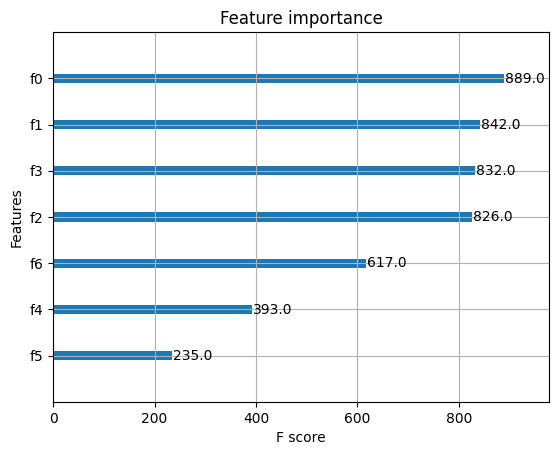

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_squared_error
import xgboost as xgb


# Select features and target
features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long', 'bathrooms', 'bedrooms', 'sqft_lot']
X = data[features]
y = data['price']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the parameter grid
param_dist = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'max_depth': [3, 4, 5, 6, 7, 8, 9],
    'subsample': [0.6, 0.7, 0.8, 0.9, 1.0],
    'colsample_bytree': [0.6, 0.7, 0.8, 0.9, 1.0],
    'gamma': [0, 0.1, 0.2, 0.3, 0.4]
}

# Initialize the XGBoost regressor
xgb_regressor = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Perform Randomized Search with cross-validation
random_search = RandomizedSearchCV(xgb_regressor, param_distributions=param_dist, n_iter=50, scoring='neg_mean_squared_error', cv=5, verbose=1, random_state=42, n_jobs=-1)
random_search.fit(X_train_scaled, y_train)

# Get the best parameters and model
best_params = random_search.best_params_
print(f'Best Parameters: {best_params}')
best_model = random_search.best_estimator_

# Evaluate the model
y_pred = best_model.predict(X_test_scaled)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'RMSE: {rmse}')

# Feature Importance
xgb.plot_importance(best_model)
plt.show()


**Interpretation of Feature Importance**
The feature importance plot from XGBoost shows the relative importance of each feature in predicting the target variable (house price). Here are the features and their importance scores:

**f0 (grade_living):**  889.0

**f1 (lat):** 842.0

**f2 (nearest_station_distance_km):** 826.0

**f3 (long):** 832.0


**f4 (bathrooms):** 617.0

**f5 (bedrooms):** 393.0

**f6 (sqft_lot):** 235.0

**Analysis**

**Grade Living (f0):** This feature has the highest importance score, indicating it is the most influential in predicting house prices.

**Latitude (f1)** and **Longitude (f3):** Both geographic features are highly important, suggesting location plays a significant role in determining house prices.

**Nearest Station Distance (f2):** Proximity to a station is also a critical factor.

**Bathrooms (f4) and Bedrooms (f5):** These features are moderately important.

**Sqft Lot (f6):**  This feature has the lowest importance, indicating it has less influence compared to others.

**Steps for Further Improvement**

> To achieve even better price predictions, consider the following advanced techniques and strategies:

**Advanced Feature Engineering:**


> **Interaction Features:** Create interaction terms between important features. For example, combining grade living with location features.


> **Polynomial Features:** Generate polynomial features to capture non-linear relationships.


> **Geospatial Features:** Add more geospatial features, such as distance to city center, proximity to amenities, or neighborhood quality scores.




> **Model Stacking and Ensembling:** Combine multiple models to leverage their strengths. For example, stack predictions from RandomForest, Gradient Boosting, XGBoost, and Neural Networks.
Use techniques like bagging, boosting, and stacking to improve model robustness and accuracy.


> **Hyperparameter Tuning:** Continue fine-tuning the hyperparameters using techniques like Bayesian optimization, which can be more efficient than grid or random search.


> **Data Augmentation:** Increase the dataset by augmenting it with synthetic data or by combining multiple data sources.





> **Handling Outliers and Missing Values:** Identify and handle outliers more effectively, possibly using robust scaling techniques or outlier detection algorithms.
Ensure any missing values are imputed accurately to avoid bias in the model.



> **Regularization Techniques:** Apply regularization techniques to prevent overfitting, such as L1 (Lasso), L2 (Ridge), or Elastic Net.




> **Ensemble Learning with Advanced Algorithms:** Consider using LightGBM or CatBoost, which are often more efficient and accurate than XGBoost for certain datasets.
Explore neural network architectures, especially if you have a large dataset.





**Second Trial**

Fitting 5 folds for each of 50 candidates, totalling 250 fits
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001675 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1311
[LightGBM] [Info] Number of data points in the train set: 15129, number of used features: 7
[LightGBM] [Info] Start training from score 537640.173177
Best Parameters: {'subsample': 0.7, 'reg_lambda': 0, 'reg_alpha': 0.5, 'objective': 'regression', 'num_leaves': 31, 'n_estimators': 500, 'learning_rate': 0.2, 'colsample_bytree': 0.7, 'boosting_type': 'dart'}
RMSE: 142533.0224616914


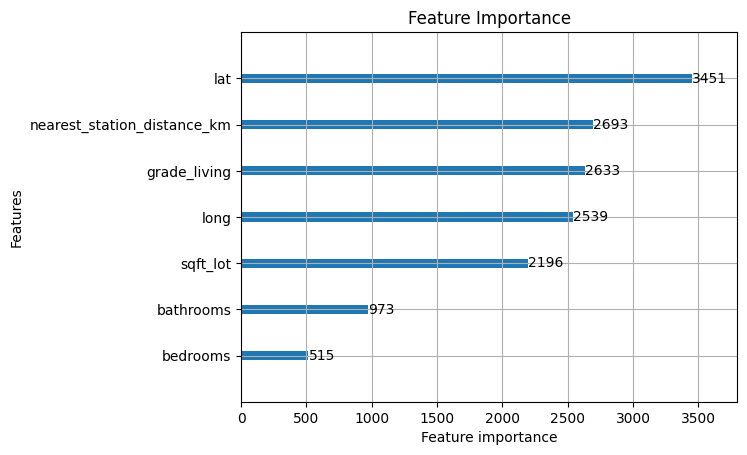

In [ ]:
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_squared_error
import lightgbm as lgb
import matplotlib.pyplot as plt


# Select features and target
features = ['grade_living', 'lat', 'nearest_station_distance_km', 'long', 'bathrooms', 'bedrooms', 'sqft_lot']
X = data[features]
y = data['price']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the LightGBM model
lgb_regressor = lgb.LGBMRegressor(random_state=42)

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'num_leaves': [31, 50, 100],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'n_estimators': [100, 200, 500],
    'boosting_type': ['gbdt', 'dart'],
    'objective': ['regression'],
    'subsample': [0.7, 0.8, 0.9, 1.0],
    'colsample_bytree': [0.7, 0.8, 0.9, 1.0],
    'reg_alpha': [0, 0.1, 0.5],
    'reg_lambda': [0, 0.1, 0.5]
}

# Perform Randomized Search with cross-validation
random_search = RandomizedSearchCV(estimator=lgb_regressor, param_distributions=param_grid, n_iter=50, scoring='neg_mean_squared_error', cv=5, verbose=1, random_state=42, n_jobs=-1)
random_search.fit(X_train, y_train)

# Get the best parameters and model
best_params = random_search.best_params_
print(f'Best Parameters: {best_params}')
best_model = random_search.best_estimator_

# Evaluate the model
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'RMSE: {rmse}')

# Feature Importance
lgb.plot_importance(best_model, max_num_features=10)
plt.title("Feature Importance")
plt.show()


In [6]:
data = df.copy()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.33043006816453624
         nearest_station_distance_km  grade_living      density  commute_time  \
Cluster                                                                         
0                       27780.411373  15028.137469  2322.795344     33.404936   
1                        6189.594316  11819.429665  7546.651994     28.524774   
2                       12925.867896  27455.493267  4037.524626     28.529220   

               long  bathrooms     yr_built        lat          price  
Cluster                                                                
0       -122.120830   2.096177  1983.153823  47.421018  362130.458966  
1       -122.305758   1.694205  1951.594046  47.622914  489878.781074  
2       -122.171041   2.867644  1989.471869  47.625062  849997.352334  


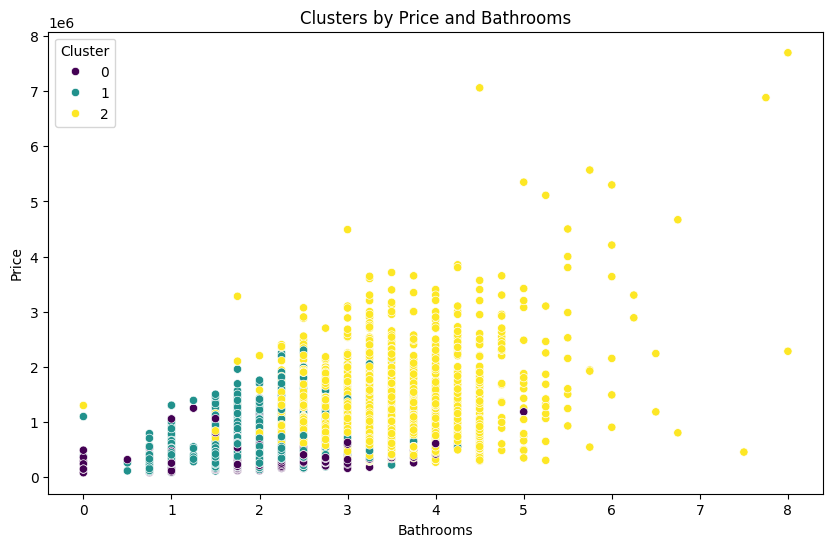

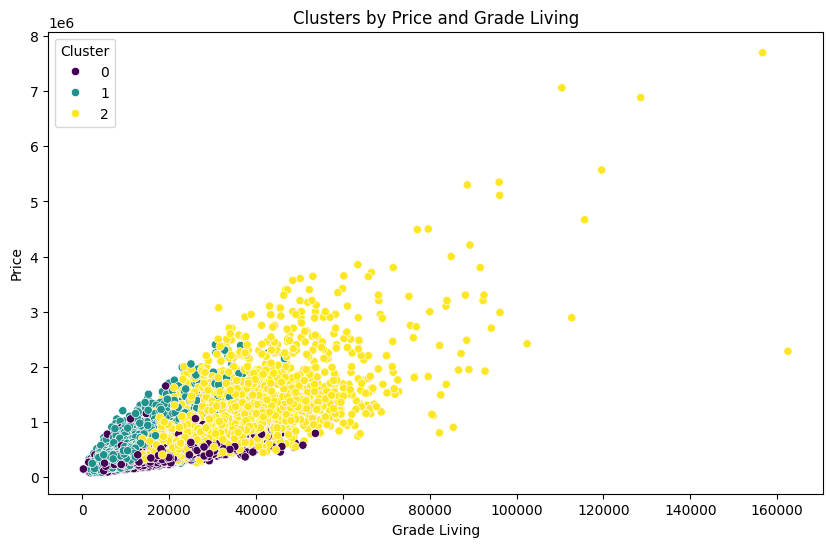

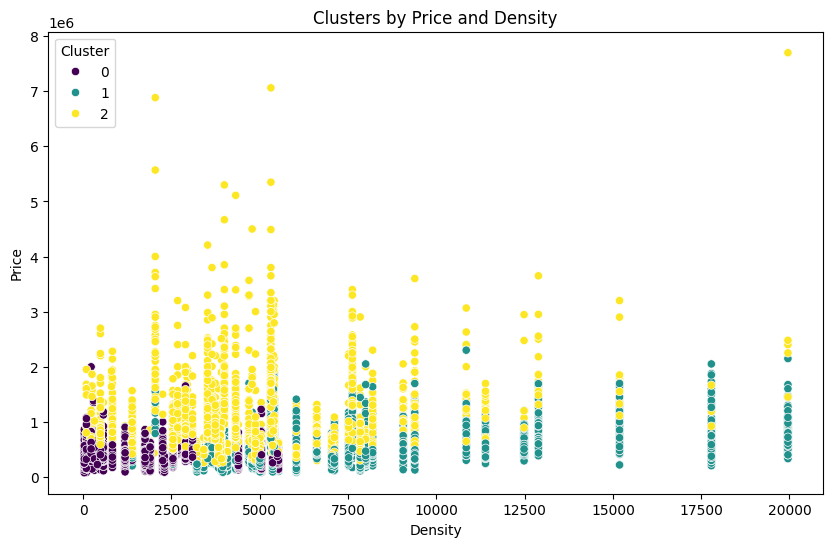

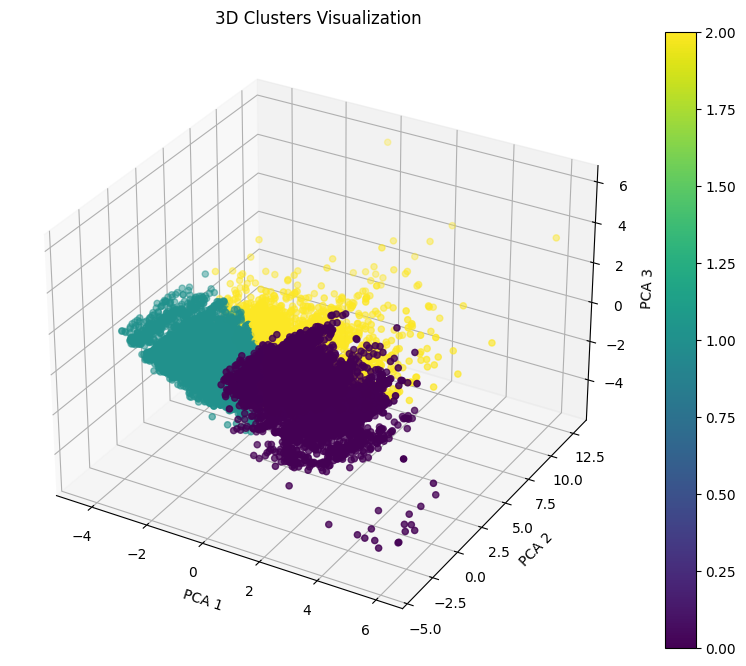


Cluster 1 Regression Model Evaluation:
Linear Regression RMSE: 141540.6246063929
Random Forest RMSE: 113296.58570000857
SVR RMSE: 244639.25397396967
Best Model for Cluster 1: Random Forest with RMSE 113296.58570000857

Cluster 0 Regression Model Evaluation:
Linear Regression RMSE: 85275.82326971959
Random Forest RMSE: 67300.8622471568
SVR RMSE: 148213.28052529632
Best Model for Cluster 0: Random Forest with RMSE 67300.8622471568

Cluster 2 Regression Model Evaluation:
Linear Regression RMSE: 298337.2094069809
Random Forest RMSE: 236172.65237642673
SVR RMSE: 542254.1423968021
Best Model for Cluster 2: Random Forest with RMSE 236172.65237642673


In [7]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D


# Selecting important features (excluding 'price' for clustering)
selected_features = [
    'nearest_station_distance_km', 'grade_living', 'density',
    'commute_time', 'long', 'bathrooms', 'yr_built', 'lat'
]

# Standardize the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# PCA for dimensionality reduction (optional)
pca = PCA(n_components=3)
data_features_pca = pca.fit_transform(data_features_scaled)

# K-means clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette analysis
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features + ['price']].mean()
print(cluster_profile)

# Function to plot 2D scatter plot for various features
def plot_scatter(x, y, xlabel, ylabel, title):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=x, y=y, hue=data['Cluster'], palette='viridis')
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

plot_scatter(data['bathrooms'], data['price'], 'Bathrooms', 'Price', 'Clusters by Price and Bathrooms')
plot_scatter(data['grade_living'], data['price'], 'Grade Living', 'Price', 'Clusters by Price and Grade Living')
plot_scatter(data['density'], data['price'], 'Density', 'Price', 'Clusters by Price and Density')

# 3D Scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(data_features_pca[:, 0], data_features_pca[:, 1], data_features_pca[:, 2],
                     c=data['Cluster'], cmap='viridis')
ax.set_title('3D Clusters Visualization')
ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')
plt.colorbar(scatter)
plt.show()

# Separate regression models for each cluster
def evaluate_regression_models(X_train, X_test, y_train, y_test):
    models = {
        'Linear Regression': LinearRegression(),
        'Random Forest': RandomForestRegressor(random_state=42),
        'SVR': SVR()
    }
    results = {}

    for name, model in models.items():
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        results[name] = rmse
        print(f'{name} RMSE: {rmse}')

    return results

X = data[selected_features]
y = data['price']

# Evaluate regression models for each cluster
for cluster in data['Cluster'].unique():
    print(f'\nCluster {cluster} Regression Model Evaluation:')
    cluster_data = data[data['Cluster'] == cluster]
    X_cluster = cluster_data[selected_features]
    y_cluster = cluster_data['price']

    X_train, X_test, y_train, y_test = train_test_split(X_cluster, y_cluster, test_size=0.3, random_state=42)
    results = evaluate_regression_models(X_train, X_test, y_train, y_test)
    best_model_name = min(results, key=results.get)
    print(f'Best Model for Cluster {cluster}: {best_model_name} with RMSE {results[best_model_name]}')


********

1. Step ----> **Clustering**

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

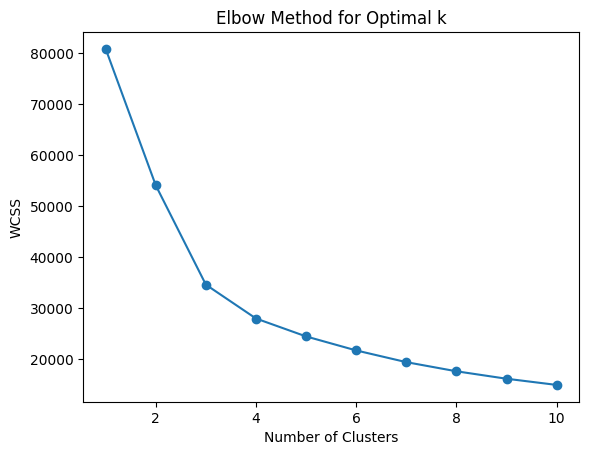

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

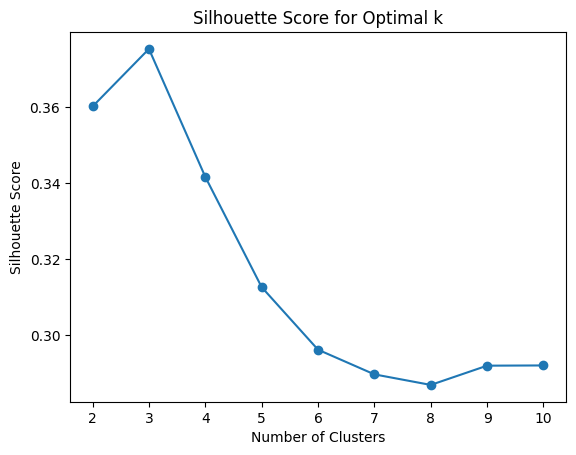

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


         nearest_station_distance_km  grade_living  bathrooms        lat
Cluster                                                                 
0                        7645.794509  11359.258875   1.668005  47.629644
1                       28476.924052  14721.859410   2.081508  47.381632
2                       12971.174903  28116.908604   2.922080  47.618179


In [10]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt


# Selecting important features (excluding 'price' for clustering)
selected_features = ['nearest_station_distance_km', 'grade_living',
                      'bathrooms',  'lat']

# Standardize the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# PCA for dimensionality reduction (optional)
pca = PCA(n_components=3)
data_features_pca = pca.fit_transform(data_features_scaled)

# Determine the optimal number of clusters using the Elbow method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(data_features_pca)
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

# Determine the optimal number of clusters using Silhouette score
sil_scores = []
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    clusters = kmeans.fit_predict(data_features_pca)
    sil_scores.append(silhouette_score(data_features_pca, clusters))

plt.plot(range(2, 11), sil_scores, marker='o')
plt.title('Silhouette Score for Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

# Using the optimal number of clusters determined above
optimal_clusters = 3  # Assume 3 is optimal from the Elbow or Silhouette method
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features].mean()
print(cluster_profile)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

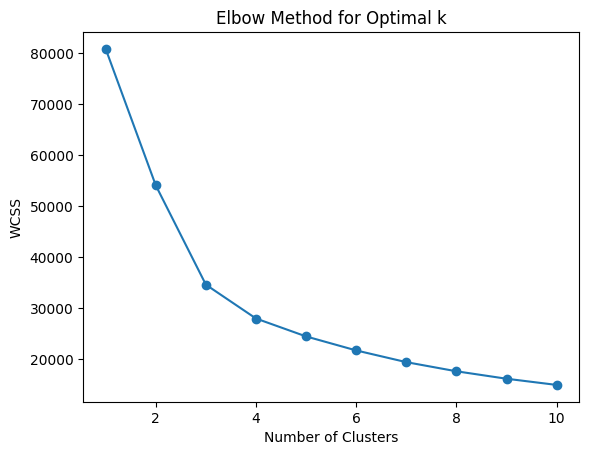

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

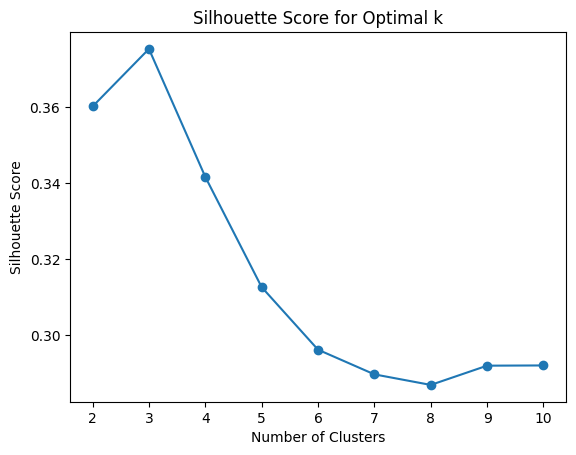

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.3753803093969532
         nearest_station_distance_km  grade_living  bathrooms        lat  \
Cluster                                                                    
0                        7645.794509  11359.258875   1.668005  47.629644   
1                       28476.924052  14721.859410   2.081508  47.381632   
2                       12971.174903  28116.908604   2.922080  47.618179   

                 price  
Cluster                 
0        462132.239031  
1        334946.668277  
2        880611.105563  

Cluster 0 Regression Model Evaluation:
XGBoost RMSE: 99985.13265989236
Best Model for Cluster 0: XGBoost with RMSE 99985.13265989236

Cluster 2 Regression Model Evaluation:
XGBoost RMSE: 263192.6373945292
Best Model for Cluster 2: XGBoost with RMSE 263192.6373945292

Cluster 1 Regression Model Evaluation:
XGBoost RMSE: 74573.55040225582
Best Model for Cluster 1: XGBoost with RMSE 74573.55040225582


In [11]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split, GridSearchCV
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D


# Selecting important features (excluding 'price' for clustering)
selected_features = ['nearest_station_distance_km', 'grade_living',
                     'bathrooms',  'lat']

# Standardize the selected features
scaler = StandardScaler()
data_features_scaled = scaler.fit_transform(data[selected_features])

# PCA for dimensionality reduction (optional)
pca = PCA(n_components=3)
data_features_pca = pca.fit_transform(data_features_scaled)

# Determine the optimal number of clusters using the Elbow method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(data_features_pca)
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

# Determine the optimal number of clusters using Silhouette score
sil_scores = []
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    clusters = kmeans.fit_predict(data_features_pca)
    sil_scores.append(silhouette_score(data_features_pca, clusters))

plt.plot(range(2, 11), sil_scores, marker='o')
plt.title('Silhouette Score for Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

# Using the optimal number of clusters determined above
optimal_clusters = 3  # Assume 3 is optimal from the Elbow or Silhouette method
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
clusters = kmeans.fit_predict(data_features_pca)
data['Cluster'] = clusters

# Silhouette analysis
silhouette_avg = silhouette_score(data_features_pca, clusters)
print(f'Silhouette Score: {silhouette_avg}')

# Cluster profiling
cluster_profile = data.groupby('Cluster')[selected_features + ['price']].mean()
print(cluster_profile)

# Function to evaluate regression models
def evaluate_regression_models(X_train, X_test, y_train, y_test):
    models = {
        'XGBoost': XGBRegressor(random_state=42)
    }
    results = {}

    for name, model in models.items():
        param_grid = {
            'n_estimators': [100, 200],
            'max_depth': [3, 5, 7],
            'learning_rate': [0.01, 0.1, 0.2],
            'subsample': [0.8, 1.0],
            'colsample_bytree': [0.8, 1.0]
        }
        grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
        grid_search.fit(X_train, y_train)
        best_model = grid_search.best_estimator_

        y_pred = best_model.predict(X_test)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        results[name] = (rmse, best_model)
        print(f'{name} RMSE: {rmse}')

    return results

X = data[selected_features]
y = data['price']

# Evaluate regression models for each cluster
best_models = {}
for cluster in data['Cluster'].unique():
    print(f'\nCluster {cluster} Regression Model Evaluation:')
    cluster_data = data[data['Cluster'] == cluster]
    X_cluster = cluster_data[selected_features]
    y_cluster = cluster_data['price']

    X_train, X_test, y_train, y_test = train_test_split(X_cluster, y_cluster, test_size=0.3, random_state=42)
    results = evaluate_regression_models(X_train, X_test, y_train, y_test)
    best_model_name, best_model = min(results.items(), key=lambda x: x[1][0])
    best_models[cluster] = best_model
    print(f'Best Model for Cluster {cluster}: {best_model_name} with RMSE {results[best_model_name][0]}')
